# BUSINESS CASE 1 - WONDERFUL  WORLD OF WINES

In [1]:
#import all necessary libraries
import os
from pathlib import Path
from math import ceil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from joblib import dump
from pandas_profiling import ProfileReport
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.metrics import classification_report, confusion_matrix, precision_score
import sqlite3
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from math import ceil
import datetime as dt
from pandas_profiling import ProfileReport
from sklearn.impute import KNNImputer
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler
from sklearn.metrics import silhouette_score, silhouette_samples
from sklearn.cluster import DBSCAN, KMeans, AgglomerativeClustering, MeanShift, estimate_bandwidth
from sklearn.neighbors import KNeighborsClassifier, NearestNeighbors
from sklearn.base import clone
from sklearn.metrics import pairwise_distances
from scipy.cluster.hierarchy import dendrogram
from sklearn.manifold import TSNE
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder

import matplotlib.cm as cm
from scipy.stats import iqr
from scipy.stats import entropy

from sklearn.mixture import GaussianMixture
from sklearn.metrics import davies_bouldin_score
from sklearn import metrics  

#! pip install phik
import phik

In [ ]:
#we removed the column Rand in excel directly

In [2]:
# Load data 
www = pd.read_excel('WonderfulWinesoftheWorld.xlsx')

In [ ]:
# if your excel file have the variable Rand please run this code
#www.drop(["Rand"], axis=1, inplace =True)

### Describe, explore and assess data quality

In [3]:
# Display info
www.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 29 columns):
 #   Column       Non-Null Count  Dtype
---  ------       --------------  -----
 0   Custid       10000 non-null  int64
 1   Dayswus      10000 non-null  int64
 2   Age          10000 non-null  int64
 3   Edu          10000 non-null  int64
 4   Income       10000 non-null  int64
 5   Kidhome      10000 non-null  int64
 6   Teenhome     10000 non-null  int64
 7   Freq         10000 non-null  int64
 8   Recency      10000 non-null  int64
 9   Monetary     10000 non-null  int64
 10  LTV          10000 non-null  int64
 11  Perdeal      10000 non-null  int64
 12  Dryred       10000 non-null  int64
 13  Sweetred     10000 non-null  int64
 14  Drywh        10000 non-null  int64
 15  Sweetwh      10000 non-null  int64
 16  Dessert      10000 non-null  int64
 17  Exotic       10000 non-null  int64
 18  WebPurchase  10000 non-null  int64
 19  WebVisit     10000 non-null  int64
 20  SMRack 

In [4]:
# Display top 15 rows

pd.set_option('max_columns', None)
www.head()


,Custid,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend
0,5325,653,55,20,78473,0,0,20,18,826,445,7,67,4,26,2,1,1,36,5,0,0,0,0,0,0,0,0,0
1,3956,1041,75,18,105087,0,0,36,33,1852,539,2,49,0,46,1,3,0,20,4,0,0,0,1,0,0,0,0,0
2,3681,666,18,12,27984,1,0,4,56,39,-7,88,4,29,14,32,21,48,60,8,0,0,0,0,0,0,0,0,0
3,2829,1049,42,16,61748,1,1,2,46,37,-6,70,86,1,11,1,1,55,59,7,0,0,0,0,0,0,0,1,1
4,8788,837,47,16,65789,0,1,2,3,36,4,35,85,0,12,2,1,28,63,6,0,0,0,0,0,0,0,0,0


In [5]:
#put costumer id as index
www.set_index("Custid", inplace=True)

In [6]:
# Summary statistics for all variables
www.describe(include='all').transpose()

,count,mean,std,min,25%,50%,75%,max
Dayswus,10000.0,898.1020,202.492789,550.0,723.75,894.0,1074.00,1250.0
Age,10000.0,47.9273,17.302721,18.0,33.00,48.0,63.00,78.0
Edu,10000.0,16.7391,1.876375,12.0,15.00,17.0,18.00,20.0
Income,10000.0,69904.3580,27612.233311,10000.0,47642.00,70012.0,92147.00,140628.0
Kidhome,10000.0,0.4188,0.493387,0.0,0.00,0.0,1.00,1.0
Teenhome,10000.0,0.4698,0.499112,0.0,0.00,0.0,1.00,1.0
Freq,10000.0,14.6281,11.969073,1.0,4.00,12.0,24.00,56.0
Recency,10000.0,62.4068,69.874255,0.0,26.00,52.0,78.25,549.0
Monetary,10000.0,622.5552,647.135323,6.0,63.00,383.0,1077.00,3052.0
LTV,10000.0,209.0712,291.986040,-178.0,-2.00,57.0,364.00,1791.0


In [7]:
# Check missing values
www.isnull().sum()

Dayswus        0
Age            0
Edu            0
Income         0
Kidhome        0
Teenhome       0
Freq           0
Recency        0
Monetary       0
LTV            0
Perdeal        0
Dryred         0
Sweetred       0
Drywh          0
Sweetwh        0
Dessert        0
Exotic         0
WebPurchase    0
WebVisit       0
SMRack         0
LGRack         0
Humid          0
Spcork         0
Bucket         0
Access         0
Complain       0
Mailfriend     0
Emailfriend    0
dtype: int64

In [8]:
# Check duplicated observations
www.loc[www.duplicated(keep=False), :]

,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend
Custid,,,,,,,,,,,,,,,,,,,,,,,,,,,,


In [9]:
# Define metric and non-metric features
metric_features = ["Dayswus", "Age", "Edu", "Income", "Freq", "Recency", "Monetary","LTV", "Perdeal", "Dryred", "Sweetred", "Drywh", "Sweetwh", "Dessert", "Exotic", "WebPurchase", "WebVisit", "Access"]
non_metric_features = www.columns.drop(metric_features).to_list()

In [10]:
#perspectives of analysis
socio=["Age", "Edu", "Income"]
cust_behavior =["Dayswus", "WebPurchase", "WebVisit", "Access", "Freq", "Recency", "Monetary","LTV", "Perdeal", "Dryred", "Sweetred", "Drywh", "Sweetwh", "Dessert", "Exotic"]



In [11]:
# Pandas profiling

ProfileReport(www[metric_features])

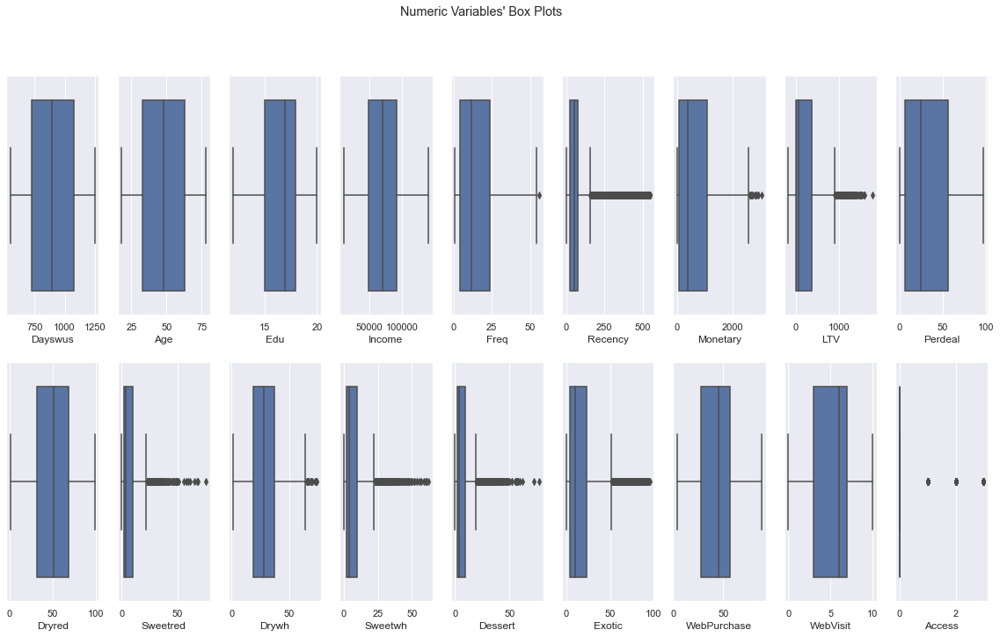

In [12]:
# All Numeric Variables' Box Plots in one figure
sns.set()


fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))


for ax, feat in zip(axes.flatten(), metric_features): 
    sns.boxplot(x=www[feat], ax=ax)
    
title = "Numeric Variables' Box Plots"

plt.suptitle(title)


plt.show()

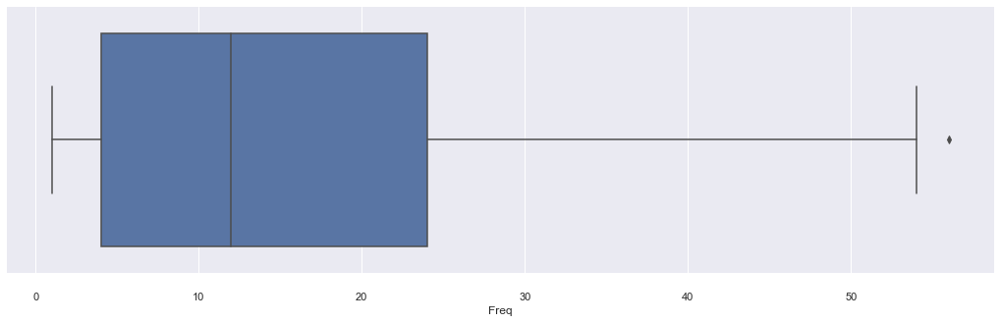

In [13]:
#Boxplot of Frequency
fig, ax = plt.subplots(figsize=(18, 5))
sns.boxplot(x="Freq",
            data=www,
            ax = ax)
sns.despine(offset=10, trim=True)
plt.show()

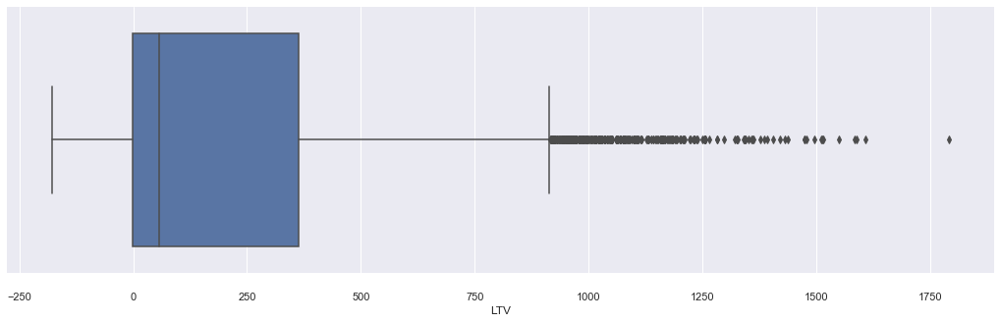

In [14]:
#Boxplot of LTV
fig, ax = plt.subplots(figsize=(18, 5))
sns.boxplot(x="LTV",
            data=www,
            ax = ax)
sns.despine(offset=10, trim=True)
plt.show()

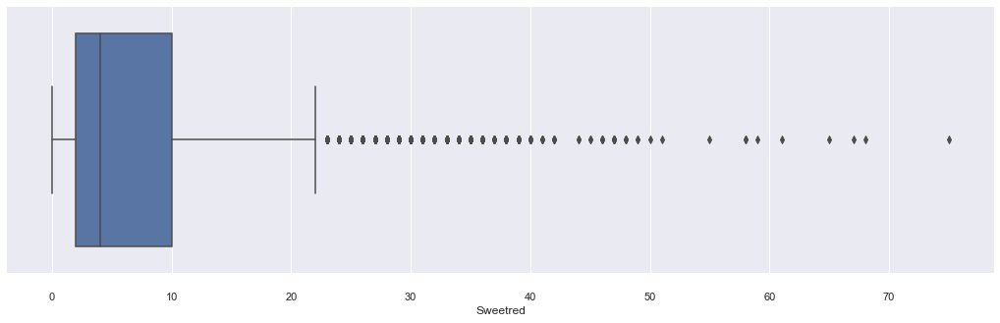

In [15]:
#Boxplot of Sweetred
fig, ax = plt.subplots(figsize=(18, 5))
sns.boxplot(x="Sweetred",
            data=www,
            ax = ax)
sns.despine(offset=10, trim=True)
plt.show()

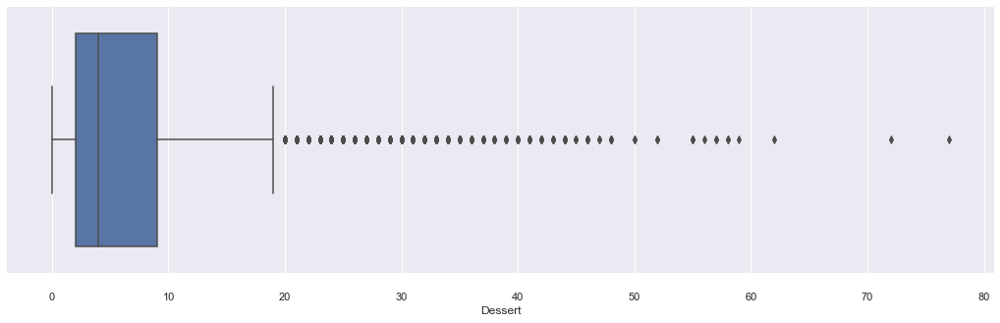

In [16]:
#Boxplot of Dessert

fig, ax = plt.subplots(figsize=(18, 5))
sns.boxplot(x="Dessert",
            data=www,
            ax = ax)
sns.despine(offset=10, trim=True)
plt.show()

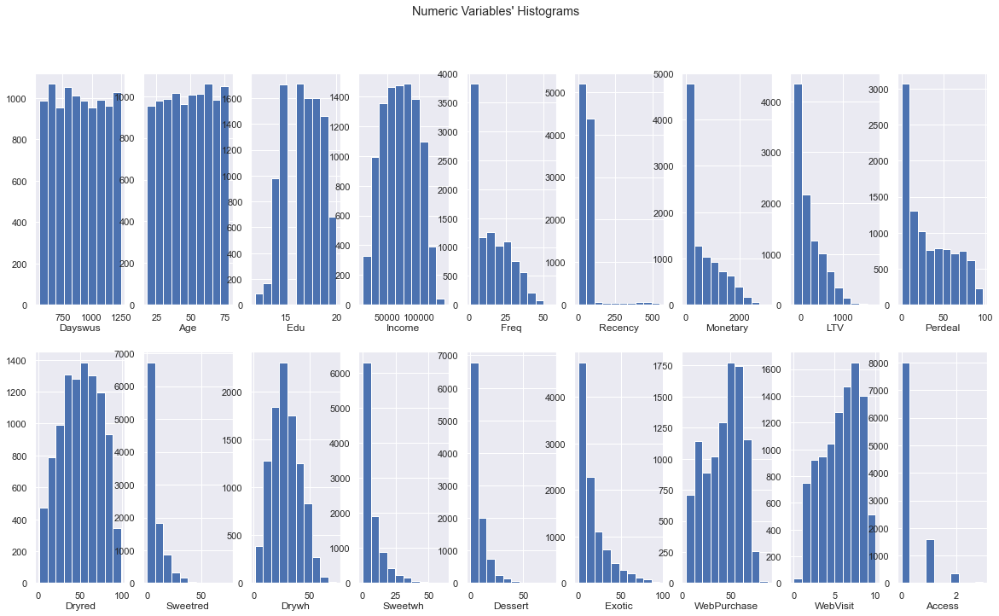

In [17]:
# All Numeric Variables' Histograms in one figure
sns.set()

fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))


for ax, feat in zip(axes.flatten(), metric_features): 
    ax.hist(www[feat])
    ax.set_title(feat, y=-0.13)
    

title = "Numeric Variables' Histograms"

plt.suptitle(title)


plt.show()

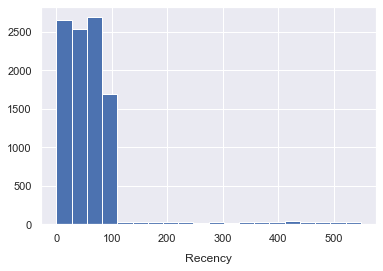

In [18]:
# Recency Histogram
plt.hist(www["Recency"], bins=20)  # mess around with the bins
plt.title("Recency", y=-0.2)

plt.show()

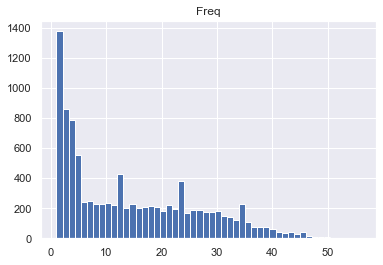

In [19]:
# Frequency Histogram
plt.hist(www["Freq"], bins=50)  # mess around with the bins
plt.title("Freq")

plt.show()


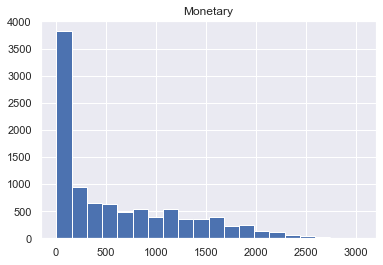

In [20]:
# Monetary Histogram
plt.hist(www["Monetary"], bins=20)  # mess around with the bins
plt.title("Monetary")

plt.show()

D:\gftou\Anaconda\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
D:\gftou\Anaconda\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
D:\gftou\Anaconda\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
D:\gftou\Anaconda\lib\site-packages\seaborn\_decorat

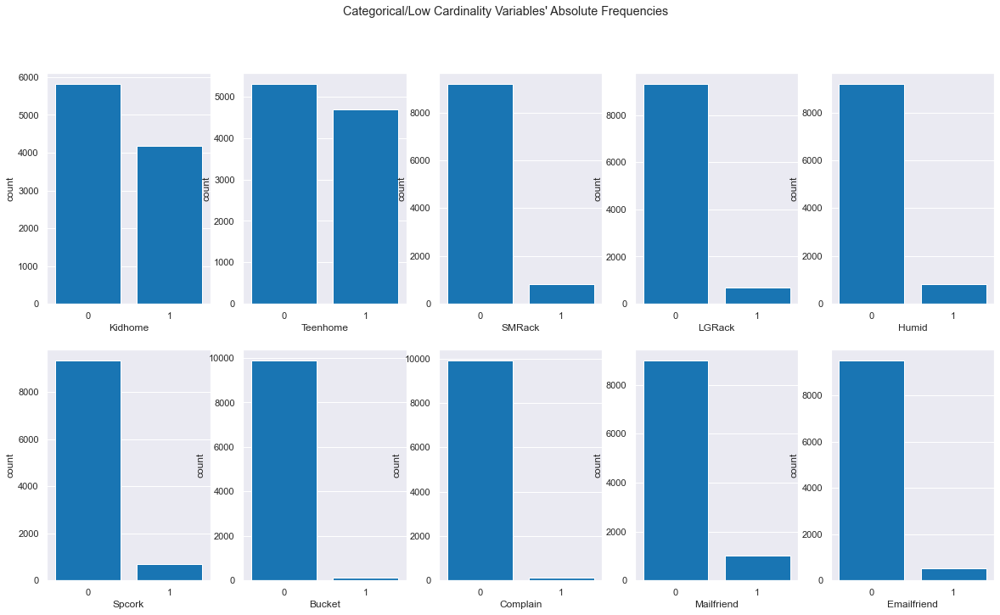

In [21]:
# All Non-Metric Variables' Absolute Frequencies
sns.set()

fig, axes = plt.subplots(2, ceil(len(non_metric_features) / 2), figsize=(20, 11))

for ax, feat in zip(axes.flatten(), non_metric_features): 
    sns.countplot(www[feat], ax=ax, color='#007acc')

title = "Categorical/Low Cardinality Variables' Absolute Frequencies"
plt.suptitle(title)

plt.show()

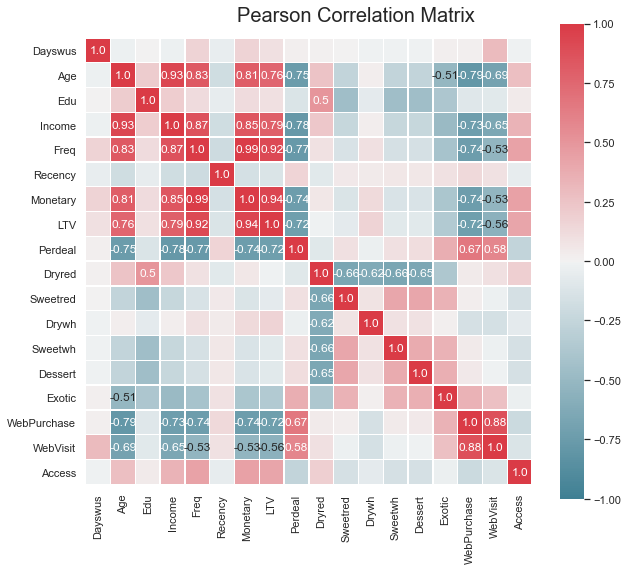

In [22]:
#Pearson Cprrelation

fig = plt.figure(figsize=(10, 8))

corr = np.round(www[metric_features].corr(method="pearson"), decimals=2)

mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape,""))

sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)
fig.subplots_adjust(top=0.95)
fig.suptitle("Pearson Correlation Matrix", fontsize=20)

plt.show()

interval columns not set, guessing: ['Dayswus', 'Age', 'Edu', 'Income', 'Kidhome', 'Teenhome', 'Freq', 'Recency', 'Monetary', 'LTV', 'Perdeal', 'Dryred', 'Sweetred', 'Drywh', 'Sweetwh', 'Dessert', 'Exotic', 'WebPurchase', 'WebVisit', 'SMRack', 'LGRack', 'Humid', 'Spcork', 'Bucket', 'Access', 'Complain', 'Mailfriend', 'Emailfriend']


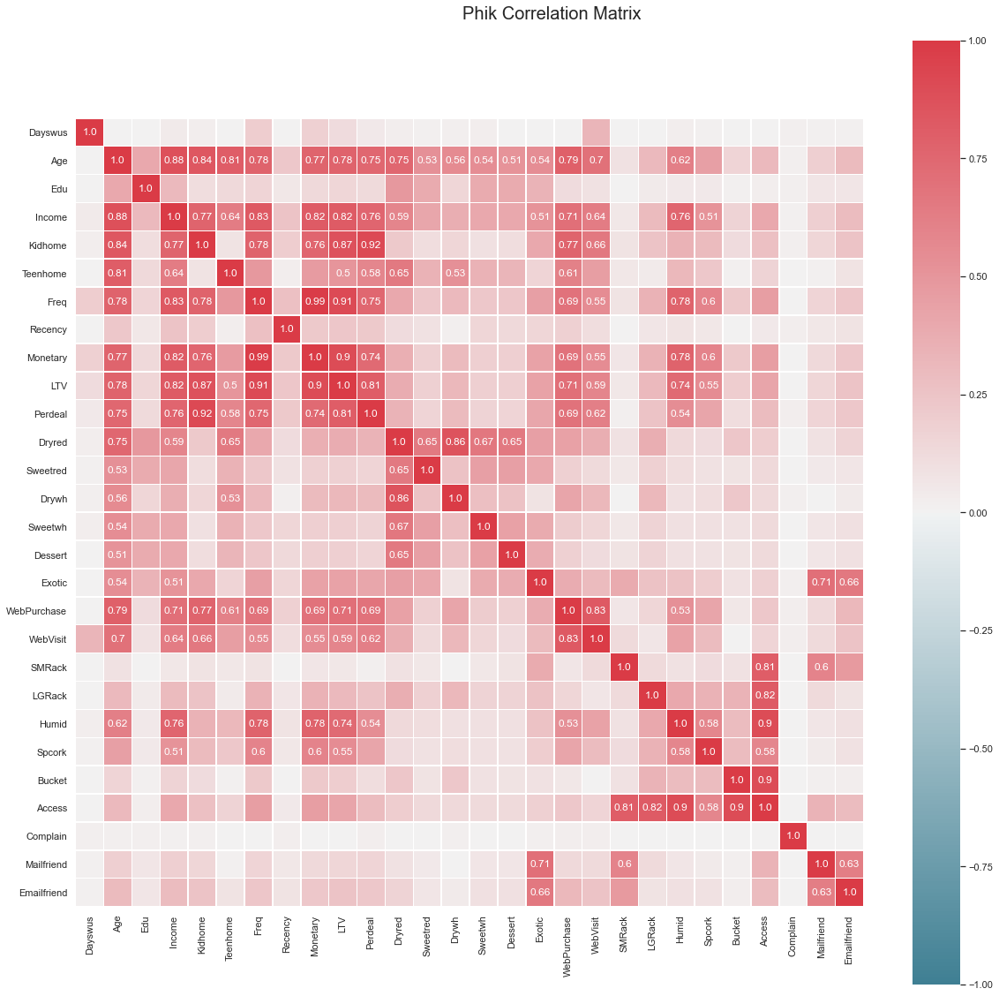

In [23]:

# Phik correlation

fig = plt.figure(figsize=(20, 18))

corr_phik=np.round(www.phik_matrix(), decimals=2)

mask_annot = np.absolute(corr_phik.values) >= 0.5
annot = np.where(mask_annot, corr_phik.values, np.full(corr_phik.shape,""))


sns.heatmap(data=corr_phik, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

fig.subplots_adjust(top=0.95)
fig.suptitle("Phik Correlation Matrix", fontsize=20)

plt.show()


# Data Preparation

In [24]:
# for selecting data we will keep all the variables initially, but we will start by cleaning the variables that showed to have potential outliers 

### Outlier removal using only the IQR method



In [25]:
metrics_to_treat = ["Freq","LTV","Sweetred","Dessert"]

q25 = www.quantile(.25)
q75 = www.quantile(.75)
iqr = (q75 - q25)

upper_lim = q75 + 3 * iqr
lower_lim = q25 - 3 * iqr

filters2 = []
for metric in metrics_to_treat:
    llim = lower_lim[metric]
    ulim = upper_lim[metric]
    filters2.append(www[metric].between(llim, ulim, inclusive=True))

filters2 = pd.Series(np.all(filters2, 0), index=www.index.tolist())
df_2 = www[filters2]
print('Percentage of data kept after removing outliers:', np.round(df_2.shape[0] / www.shape[0], 4))

Percentage of data kept after removing outliers: 0.9664


In [26]:
www = df_2


### Construct data

In [27]:
#conversion of web visits
www["conversion"] = np.round((www["WebPurchase"]/100 *www["Freq"])/(www["WebVisit"]*18), decimals=2)

In [28]:
www["WebVisit"].unique()


array([ 5,  4,  8,  7,  6,  2,  3,  9,  1,  0, 10], dtype=int64)

In [29]:

www["conversion"].replace([np.inf, -np.inf], np.nan, inplace=True)

In [30]:
www["conversion"].fillna(0, inplace=True)

In [31]:
www["conversion"].unique()

array([0.08, 0.1 , 0.02, 0.01, 0.07, 0.06, 0.05, 0.  , 0.09, 0.04, 0.03,
       0.11, 0.13, 0.15, 0.12, 0.21, 0.16, 0.14, 0.2 , 0.24, 0.23, 0.18,
       0.19, 0.22, 0.17, 0.25, 0.31, 0.27, 0.28, 0.26, 0.29, 0.3 , 0.32,
       0.33])

In [32]:
#average ammount perpurchase
www["Avg_purchase"]=np.round(www["Monetary"]/www["Freq"], decimals=2)

In [33]:
#average days between purchases
www["Days_between"]=np.round((18*30)/www["Freq"], decimals=2)

In [34]:
#relatively spend on each product
www["Spent_dryred"]=np.round(www["Monetary"]*(www["Dryred"]/100), decimals=2)
www["Spent_sweetred"]=np.round(www["Monetary"]*(www["Sweetred"]/100), decimals=2)
www["Spent_drywh"]=np.round(www["Monetary"]*(www["Drywh"]/100), decimals=2)
www["Spent_sweetwh"]=np.round(www["Monetary"]*(www["Sweetwh"]/100), decimals=2)
www["Spent_dessert"]=np.round(www["Monetary"]*(www["Dessert"]/100), decimals=2)
www["Spent_exotic"]=np.round(www["Monetary"]*(www["Exotic"]/100), decimals=2)


In [35]:
preference_percentage=www[["Dryred","Sweetred","Drywh","Sweetwh","Dessert","Exotic"]]

In [36]:
#Based on these feature engineering we will delete the variables corresponding to the preferences percentage for now and later will add them again to interpret
www.drop(["Dryred","Sweetred","Drywh","Sweetwh","Dessert","Exotic"], axis=1, inplace=True )

In [37]:
#verify existence of nan alues
www.isna().sum()

Dayswus           0
Age               0
Edu               0
Income            0
Kidhome           0
Teenhome          0
Freq              0
Recency           0
Monetary          0
LTV               0
Perdeal           0
WebPurchase       0
WebVisit          0
SMRack            0
LGRack            0
Humid             0
Spcork            0
Bucket            0
Access            0
Complain          0
Mailfriend        0
Emailfriend       0
conversion        0
Avg_purchase      0
Days_between      0
Spent_dryred      0
Spent_sweetred    0
Spent_drywh       0
Spent_sweetwh     0
Spent_dessert     0
Spent_exotic      0
dtype: int64


# Min max Scaller

In [38]:
#perspectives of analysis
socio=["Age", "Edu", "Income"]
cust_behavior =["Dayswus", "WebPurchase", "WebVisit", "Access", "Freq", "Recency", "Monetary","LTV", "Perdeal","Spent_dryred", "Spent_sweetred","Spent_drywh","Spent_sweetwh","Spent_dessert","Spent_exotic","Days_between","Avg_purchase","conversion" ] 
metric_features=["Age", "Edu", "Income", "Dayswus", "WebPurchase", "WebVisit", "Access", "Freq", "Recency", "Monetary","LTV", "Perdeal","Spent_dryred", "Spent_sweetred","Spent_drywh","Spent_sweetwh","Spent_dessert","Spent_exotic","Days_between","Avg_purchase","conversion" ]

In [39]:
scaler = MinMaxScaler()

scalled_metric=pd.DataFrame(scaler.fit_transform(www[socio]))
scalled_metric.columns = ["Age", "Edu", "Income"]
scalled_metric

,Age,Edu,Income
0,0.616667,1.000,0.527812
1,0.950000,0.750,0.732961
2,0.000000,0.000,0.138626
3,0.400000,0.500,0.398890
4,0.483333,0.500,0.430039
...,...,...,...
9659,0.650000,1.000,0.547545
9660,0.800000,0.375,0.575919
9661,0.000000,0.000,0.234842
9662,0.250000,0.500,0.336553


In [40]:
# to check for infinite values
ds = www.isin([np.inf, -np.inf]) 

In [41]:
ds.any()

Dayswus           False
Age               False
Edu               False
Income            False
Kidhome           False
Teenhome          False
Freq              False
Recency           False
Monetary          False
LTV               False
Perdeal           False
WebPurchase       False
WebVisit          False
SMRack            False
LGRack            False
Humid             False
Spcork            False
Bucket            False
Access            False
Complain          False
Mailfriend        False
Emailfriend       False
conversion        False
Avg_purchase      False
Days_between      False
Spent_dryred      False
Spent_sweetred    False
Spent_drywh       False
Spent_sweetwh     False
Spent_dessert     False
Spent_exotic      False
dtype: bool

In [42]:
scalled_metric_beh=pd.DataFrame(scaler.fit_transform(www[cust_behavior]))
scalled_metric_beh.columns = ["Dayswus", "WebPurchase", "WebVisit", "Access", "Freq", "Recency", "Monetary","LTV", "Perdeal", "Spent_dryred", "Spent_sweetred","Spent_drywh","Spent_sweetwh","Spent_dessert","Spent_exotic","Days_between","Avg_purchase","conversion" ]
scalled_metric_beh

,Dayswus,WebPurchase,WebVisit,Access,Freq,Recency,Monetary,LTV,Perdeal,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Spent_exotic,Days_between,Avg_purchase,conversion
0,0.147143,0.380952,0.5,0.000000,0.358491,0.032787,0.279673,0.385520,0.072165,0.260240,0.058681,0.113875,0.021578,0.014647,0.006177,0.032075,0.729188,0.242424
1,0.701429,0.190476,0.4,0.000000,0.660377,0.060109,0.629604,0.443688,0.020619,0.426796,0.000000,0.452862,0.024190,0.098521,0.000000,0.009434,0.938649,0.303030
2,0.165714,0.666667,0.8,0.000000,0.056604,0.102004,0.011255,0.105817,0.907216,0.000635,0.020087,0.002522,0.016301,0.014523,0.013999,0.235849,0.077463,0.060606
3,0.712857,0.654762,0.7,0.000000,0.018868,0.083789,0.010573,0.106436,0.721649,0.014870,0.000657,0.001782,0.000483,0.000656,0.015218,0.490566,0.258211,0.030303
4,0.410000,0.702381,0.6,0.000000,0.018868,0.005464,0.010232,0.112624,0.360825,0.014296,0.000000,0.001915,0.000940,0.000638,0.007538,0.490566,0.247883,0.030303
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9659,0.831429,0.273810,0.4,0.333333,0.339623,0.107468,0.262619,0.225866,0.226804,0.284636,0.000000,0.082188,0.010136,0.013760,0.063834,0.034755,0.719686,0.212121
9660,0.065714,0.166667,0.2,0.000000,0.320755,0.081967,0.243520,0.352104,0.051546,0.101511,0.153453,0.137519,0.094044,0.153208,0.069996,0.037736,0.702334,0.272727
9661,0.098571,0.642857,0.5,0.000000,0.037736,0.118397,0.013984,0.113243,0.237113,0.001228,0.020034,0.002117,0.023328,0.018335,0.014410,0.320755,0.199752,0.060606
9662,0.795714,0.666667,0.6,0.000000,0.000000,0.670310,0.003070,0.111386,0.360825,0.001171,0.003463,0.003208,0.002155,0.003458,0.001458,1.000000,0.185912,0.030303


In [43]:
www_metric = []
www_metric = pd.concat([scalled_metric,scalled_metric_beh], axis = 1)
www_metric

,Age,Edu,Income,Dayswus,WebPurchase,WebVisit,Access,Freq,Recency,Monetary,LTV,Perdeal,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Spent_exotic,Days_between,Avg_purchase,conversion
0,0.616667,1.000,0.527812,0.147143,0.380952,0.5,0.000000,0.358491,0.032787,0.279673,0.385520,0.072165,0.260240,0.058681,0.113875,0.021578,0.014647,0.006177,0.032075,0.729188,0.242424
1,0.950000,0.750,0.732961,0.701429,0.190476,0.4,0.000000,0.660377,0.060109,0.629604,0.443688,0.020619,0.426796,0.000000,0.452862,0.024190,0.098521,0.000000,0.009434,0.938649,0.303030
2,0.000000,0.000,0.138626,0.165714,0.666667,0.8,0.000000,0.056604,0.102004,0.011255,0.105817,0.907216,0.000635,0.020087,0.002522,0.016301,0.014523,0.013999,0.235849,0.077463,0.060606
3,0.400000,0.500,0.398890,0.712857,0.654762,0.7,0.000000,0.018868,0.083789,0.010573,0.106436,0.721649,0.014870,0.000657,0.001782,0.000483,0.000656,0.015218,0.490566,0.258211,0.030303
4,0.483333,0.500,0.430039,0.410000,0.702381,0.6,0.000000,0.018868,0.005464,0.010232,0.112624,0.360825,0.014296,0.000000,0.001915,0.000940,0.000638,0.007538,0.490566,0.247883,0.030303
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9659,0.650000,1.000,0.547545,0.831429,0.273810,0.4,0.333333,0.339623,0.107468,0.262619,0.225866,0.226804,0.284636,0.000000,0.082188,0.010136,0.013760,0.063834,0.034755,0.719686,0.212121
9660,0.800000,0.375,0.575919,0.065714,0.166667,0.2,0.000000,0.320755,0.081967,0.243520,0.352104,0.051546,0.101511,0.153453,0.137519,0.094044,0.153208,0.069996,0.037736,0.702334,0.272727
9661,0.000000,0.000,0.234842,0.098571,0.642857,0.5,0.000000,0.037736,0.118397,0.013984,0.113243,0.237113,0.001228,0.020034,0.002117,0.023328,0.018335,0.014410,0.320755,0.199752,0.060606
9662,0.250000,0.500,0.336553,0.795714,0.666667,0.6,0.000000,0.000000,0.670310,0.003070,0.111386,0.360825,0.001171,0.003463,0.003208,0.002155,0.003458,0.001458,1.000000,0.185912,0.030303


# PCA

In [44]:
from sklearn.decomposition import PCA

In [45]:
www_pca = www_metric[metric_features].copy()

In [46]:
# PCA to reduce dimensionality 
pca = PCA(n_components=www_pca.shape[1], whiten=True)
pca_feat1 = pca.fit_transform(www_pca)
pca_feat1  

array([[ 0.52065827, -0.86009546, -1.83358544, ...,  0.52659579,
         1.5195913 ,  0.19676603],
       [ 1.44465625,  0.65822715, -0.53685124, ..., -0.63597546,
        -0.43893732, -3.87562777],
       [-1.48532529, -0.51998541,  2.15374463, ..., -2.56845252,
         1.6642554 ,  0.08465109],
       ...,
       [-0.99275639, -1.24166153,  2.26091565, ...,  0.51026929,
        -1.0778845 , -0.08591112],
       [-1.16354222,  0.32840493,  0.91053332, ..., -0.74187261,
         0.85226049,  0.04027501],
       [ 0.73958682,  0.48477868,  0.40718644, ..., -0.54433191,
         0.06960594, -0.05224483]])

In [47]:
# Output PCA table
output=pd.DataFrame(
    {"Eigenvalue": pca.explained_variance_,
     "Difference": np.insert(np.diff(pca.explained_variance_), 0, 0),
     "Proportion": pca.explained_variance_ratio_,
     "Cumulative": np.cumsum(pca.explained_variance_ratio_)},
    index=range(1, pca.n_components_ + 1)
)
output

,Eigenvalue,Difference,Proportion,Cumulative
1,0.509146,0.000000,0.587012,0.587012
2,0.102267,-0.406879,0.117907,0.704919
3,0.056152,-0.046115,0.064740,0.769658
4,0.043839,-0.012313,0.050544,0.820202
5,0.041019,-0.002821,0.047292,0.867494
6,0.026464,-0.014554,0.030511,0.898005
7,0.019819,-0.006645,0.022851,0.920856
8,0.016422,-0.003397,0.018934,0.939790
9,0.010408,-0.006014,0.012000,0.951790
10,0.008229,-0.002179,0.009487,0.961277


In [48]:
output.loc[output['Cumulative'] >= 0.79] #we need 4 Pc to have more than 80% of variance explained

,Eigenvalue,Difference,Proportion,Cumulative
4,0.043839,-0.012313,0.050544,0.820202
5,0.041019,-0.002821,0.047292,0.867494
6,0.026464,-0.014554,0.030511,0.898005
7,0.019819,-0.006645,0.022851,0.920856
8,0.016422,-0.003397,0.018934,0.939790
9,0.010408,-0.006014,0.012000,0.951790
10,0.008229,-0.002179,0.009487,0.961277
11,0.006475,-0.001754,0.007465,0.968742
12,0.005302,-0.001173,0.006113,0.974855
13,0.005024,-0.000278,0.005792,0.980647


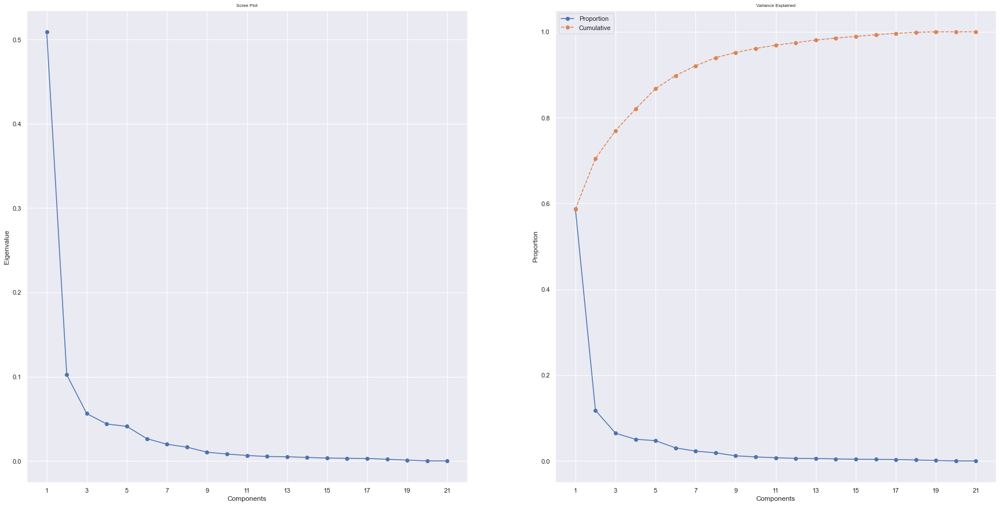

In [49]:
# figure and axes
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(30, 15))

# draw plots
ax1.plot(pca.explained_variance_, marker=".", markersize=12)
ax2.plot(pca.explained_variance_ratio_, marker=".", markersize=12, label="Proportion")
ax2.plot(np.cumsum(pca.explained_variance_ratio_), marker=".", markersize=12, linestyle="--", label="Cumulative")

# customizations
ax2.legend()
ax1.set_title("Scree Plot", fontsize=8)
ax2.set_title("Variance Explained", fontsize=8)
ax1.set_ylabel("Eigenvalue")
ax2.set_ylabel("Proportion")
ax1.set_xlabel("Components")
ax2.set_xlabel("Components")
ax1.set_xticks(range(0, pca.n_components_, 2))
ax1.set_xticklabels(range(1, pca.n_components_ + 1, 2))
ax2.set_xticks(range(0, pca.n_components_, 2))
ax2.set_xticklabels(range(1, pca.n_components_ + 1, 2))

plt.show()


In [50]:
# Perform PCA again with the number of principal components you want to retain
pca = PCA(n_components=4)
pca_feat1 = pca.fit_transform(www_pca)
pca_feat_names1 = [f"PC{i}" for i in range(pca.n_components_)]
pca_df1 = pd.DataFrame(pca_feat1, index=www_pca.index, columns=pca_feat_names1)  # remember index=df_pca.index
pca_df1

,PC0,PC1,PC2,PC3
0,0.371513,-0.275051,-0.434494,-0.107837
1,1.030827,0.210495,-0.127211,0.143365
2,-1.059846,-0.166287,0.510360,-0.356989
3,-0.727830,0.179355,0.092491,0.164190
4,-0.563144,-0.149150,0.054366,0.015614
...,...,...,...,...
9659,0.372468,0.265952,-0.383032,0.163970
9660,0.519441,-0.546315,0.250929,-0.049324
9661,-0.708376,-0.397073,0.535753,-0.310313
9662,-0.830239,0.105021,0.215762,0.579265


In [51]:
# Reassigning df to contain pca variables

www_pca = pd.concat([www_pca, pca_df1], axis=1)
www_pca .head()

,Age,Edu,Income,Dayswus,WebPurchase,WebVisit,Access,Freq,Recency,Monetary,LTV,Perdeal,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Spent_exotic,Days_between,Avg_purchase,conversion,PC0,PC1,PC2,PC3
0,0.616667,1.00,0.527812,0.147143,0.380952,0.5,0.0,0.358491,0.032787,0.279673,0.385520,0.072165,0.260240,0.058681,0.113875,0.021578,0.014647,0.006177,0.032075,0.729188,0.242424,0.371513,-0.275051,-0.434494,-0.107837
1,0.950000,0.75,0.732961,0.701429,0.190476,0.4,0.0,0.660377,0.060109,0.629604,0.443688,0.020619,0.426796,0.000000,0.452862,0.024190,0.098521,0.000000,0.009434,0.938649,0.303030,1.030827,0.210495,-0.127211,0.143365
2,0.000000,0.00,0.138626,0.165714,0.666667,0.8,0.0,0.056604,0.102004,0.011255,0.105817,0.907216,0.000635,0.020087,0.002522,0.016301,0.014523,0.013999,0.235849,0.077463,0.060606,-1.059846,-0.166287,0.510360,-0.356989
3,0.400000,0.50,0.398890,0.712857,0.654762,0.7,0.0,0.018868,0.083789,0.010573,0.106436,0.721649,0.014870,0.000657,0.001782,0.000483,0.000656,0.015218,0.490566,0.258211,0.030303,-0.727830,0.179355,0.092491,0.164190
4,0.483333,0.50,0.430039,0.410000,0.702381,0.6,0.0,0.018868,0.005464,0.010232,0.112624,0.360825,0.014296,0.000000,0.001915,0.000940,0.000638,0.007538,0.490566,0.247883,0.030303,-0.563144,-0.149150,0.054366,0.015614


In [52]:
def _color_red_or_green(val):
    if val < -0.45:
        color = 'background-color: red'
    elif val > 0.45:
        color = 'background-color: green'
    else:
        color = ''
    return color

# Interpreting each Principal Component
loadings = www_pca[metric_features + pca_feat_names1].corr().loc[metric_features, pca_feat_names1]
loadings.style.applymap(_color_red_or_green)

,PC0,PC1,PC2,PC3
Age,0.920984,-0.121940,-0.050080,0.093783
Edu,0.124348,-0.001223,-0.944491,0.263886
Income,0.935775,-0.090717,-0.054971,-0.010296
Dayswus,0.069915,0.940291,0.075727,0.274704
WebPurchase,-0.831911,0.211233,-0.126000,-0.342744
WebVisit,-0.681022,0.529339,-0.124896,-0.362088
Access,0.375996,0.072266,-0.061222,-0.326348
Freq,0.960119,0.161555,0.026532,-0.044208
Recency,-0.226778,-0.084162,0.106953,0.421237
Monetary,0.943126,0.156328,0.047340,0.002864


In [53]:
#create a list with the PC that explain 79% of the variance
pca_feat_names = [f"PC{i}" for i in range(np.argmax(np.cumsum(pca.explained_variance_ratio_) >= 0.79))]

In [54]:
#create a dataframe with the PC that explain 79% of the variance
pca_79_pct = pd.DataFrame(pca_feat1[:,0:3], index= www_pca.index, columns = pca_feat_names)

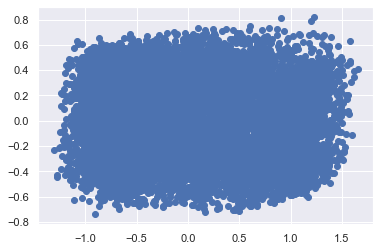

In [55]:
#plot data with the PC
plt.scatter(pca_79_pct['PC0'], pca_79_pct['PC1'])

plt.show()


# Selection


In [56]:
# Based on the correlation analysis with pearson and phisk methd we concluded to eliminate from the clustering the variable LTV. With the pca analysis we decided to exclude from the clustering the variable Recency, access, spent_exotic
metric_features=["Dayswus", "Age", "Edu", "Income", "Freq", "Monetary", "Perdeal", "WebPurchase", "WebVisit", "Spent_dryred", "Spent_sweetred","Spent_drywh","Spent_sweetwh","Spent_dessert","Days_between","Avg_purchase","conversion" ]
non_metric_features = www.columns.drop(metric_features).to_list()

In [57]:
#perspectives
socio=["Age", "Edu", "Income"]
cust_behavior =["Dayswus", "WebPurchase", "WebVisit", "Freq", "Monetary", "Perdeal","Spent_dryred", "Spent_sweetred","Spent_drywh","Spent_sweetwh","Spent_dessert","Days_between","Avg_purchase","conversion" ] 


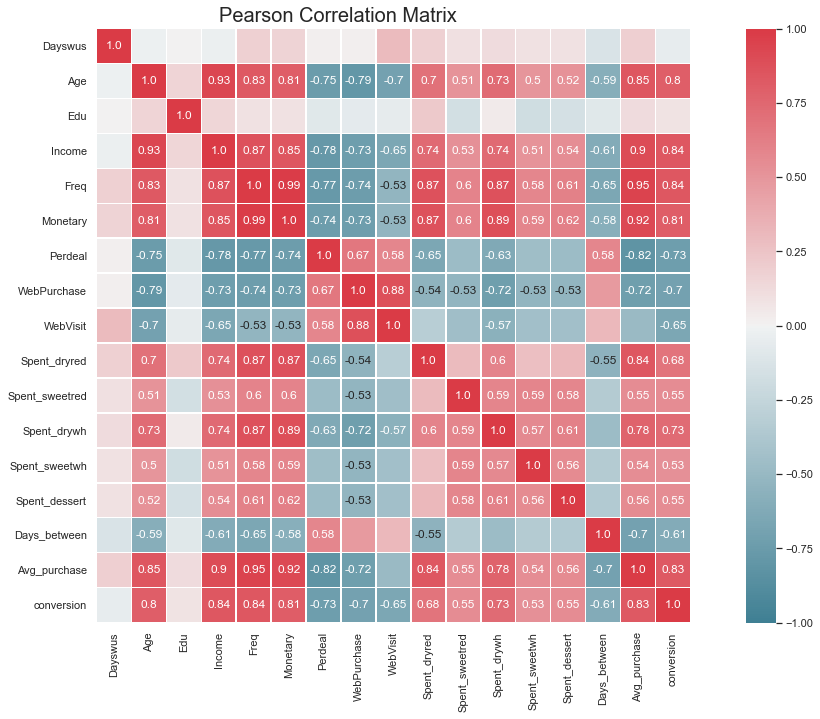

In [58]:
#Verify again the correlation betwwn the variables
# Prepare figure
fig = plt.figure(figsize=(20, 10))

# Obtain correlation matrix. Round the values to 2 decimal cases. Use the DataFrame corr() and round() method.
corr = np.round(www[metric_features].corr(method="pearson"), decimals=2)

# Build annotation matrix (values above |0.5| will appear annotated in the plot)
mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape,""))

# Plot heatmap of the correlation matrix
sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

# Layout
fig.subplots_adjust(top=0.95)
fig.suptitle("Pearson Correlation Matrix", fontsize=20)

plt.show()


# Modelling

## Kmeans less variables 

In [59]:
# we will try removing the higly correlated variables Income, Monetary and Frequency
metric_analysis=["Dayswus", "Age", "Edu", "Perdeal", "WebPurchase", "WebVisit", "Spent_dryred", "Spent_sweetred","Spent_drywh","Spent_sweetwh","Spent_dessert","Days_between","Avg_purchase","conversion" ]

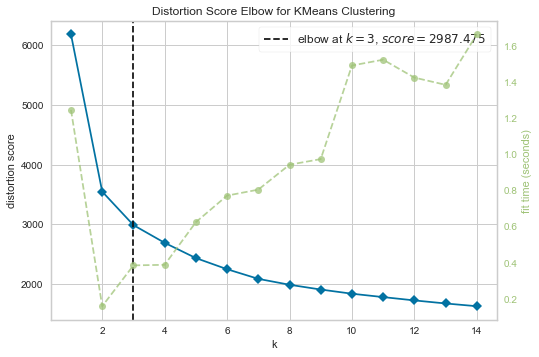

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [60]:
! pip install yellowbrick
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans


# Elbow Method for K means


inertia = KMeans(random_state=1, init='k-means++')

visualizer = KElbowVisualizer(inertia, k=(1,15), timings= True)
visualizer.fit(www_metric[metric_analysis])                           # Fit data to visualizer
visualizer.show() 

# Finalize and render figure

In [61]:
# final cluster solution
number_clusters = 3
kmclust = KMeans(n_clusters=number_clusters, init='k-means++', n_init=15, random_state=1)
km_labels_analysis = kmclust.fit_predict(www_metric[metric_analysis])
km_labels_analysis

array([0, 1, 2, ..., 2, 2, 0])

In [62]:
www=df_2

In [63]:
# Characterizing the final clusters
www_metric['analysis_labels'] = km_labels_analysis
www['analysis_labels'] = km_labels_analysis

In [64]:
kmeans_scaled_less = www_metric.groupby('analysis_labels').mean()[metric_features]

In [65]:
kmeans_scaled_less=kmeans_scaled_less.reset_index()

In [66]:
www=pd.concat([preference_percentage,www], axis=1)

In [67]:
#cluster profilling
kmeans_not_scaled_less=www.groupby('analysis_labels').mean()
kmeans_not_scaled_less

,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend,conversion,Avg_purchase,Days_between,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Spent_exotic
analysis_labels,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,65.934547,4.253193,21.384100,4.306833,4.087165,12.710089,936.928161,50.675607,17.129949,74785.206258,0.251596,0.754789,15.415070,50.057471,599.175287,151.444764,23.324074,44.826948,5.828544,0.085568,0.106003,0.017561,0.035121,0.021711,0.230843,0.008301,0.088442,0.030651,0.065038,35.932353,43.925115,403.204725,23.957877,125.188908,23.636402,22.936453,69.153870
1,45.352179,7.019445,33.913216,7.065538,6.629456,7.960389,884.999280,68.486856,16.920058,102064.994959,0.038891,0.204537,29.373785,50.139359,1430.800864,576.206338,3.859921,19.448326,2.578322,0.072380,0.120274,0.270436,0.200216,0.021246,0.484336,0.011523,0.054735,0.001080,0.130274,47.547796,19.951372,649.316024,96.508145,495.817807,97.070263,91.826133,107.509273
2,44.462317,7.999467,31.120373,8.770706,7.628762,24.025033,874.390679,32.119574,16.505992,44512.089481,0.822636,0.460719,3.705193,80.116911,75.437816,-5.179228,59.662583,56.442610,6.586684,0.087084,0.006391,0.000000,0.001864,0.000266,0.093742,0.012517,0.143009,0.098802,0.017486,18.144160,212.443534,36.382549,5.129324,23.155758,5.700815,5.055148,16.416344


In [68]:
kmeans_not_scaled_less[metric_features]

,Dayswus,Age,Edu,Income,Freq,Monetary,Perdeal,WebPurchase,WebVisit,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Days_between,Avg_purchase,conversion
analysis_labels,,,,,,,,,,,,,,,,,
0,936.928161,50.675607,17.129949,74785.206258,15.415070,599.175287,23.324074,44.826948,5.828544,403.204725,23.957877,125.188908,23.636402,22.936453,43.925115,35.932353,0.065038
1,884.999280,68.486856,16.920058,102064.994959,29.373785,1430.800864,3.859921,19.448326,2.578322,649.316024,96.508145,495.817807,97.070263,91.826133,19.951372,47.547796,0.130274
2,874.390679,32.119574,16.505992,44512.089481,3.705193,75.437816,59.662583,56.442610,6.586684,36.382549,5.129324,23.155758,5.700815,5.055148,212.443534,18.144160,0.017486


In [69]:
kmeans_not_scaled_less[socio]

,Age,Edu,Income
analysis_labels,,,
0,50.675607,17.129949,74785.206258
1,68.486856,16.920058,102064.994959
2,32.119574,16.505992,44512.089481


In [70]:
kmeans_not_scaled_less[cust_behavior]

,Dayswus,WebPurchase,WebVisit,Freq,Monetary,Perdeal,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Days_between,Avg_purchase,conversion
analysis_labels,,,,,,,,,,,,,,
0,936.928161,44.826948,5.828544,15.415070,599.175287,23.324074,403.204725,23.957877,125.188908,23.636402,22.936453,43.925115,35.932353,0.065038
1,884.999280,19.448326,2.578322,29.373785,1430.800864,3.859921,649.316024,96.508145,495.817807,97.070263,91.826133,19.951372,47.547796,0.130274
2,874.390679,56.442610,6.586684,3.705193,75.437816,59.662583,36.382549,5.129324,23.155758,5.700815,5.055148,212.443534,18.144160,0.017486


In [71]:
kmeans_not_scaled_less=kmeans_not_scaled_less.reset_index()

In [72]:
df_counts = www.groupby('analysis_labels')\
.size()\
.to_frame()

In [73]:
df_counts.rename(columns={0: "Size"},inplace=True)
df_counts

,Size
analysis_labels,
0,3132
1,2777
2,3755


In [74]:
#por na dataset as labels e depois groupby age

In [75]:
# using R^2
def get_ss(df):
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  
sst = get_ss(www_metric[metric_analysis]) 
ssw_labels = www_metric[metric_analysis + ["analysis_labels"]].groupby(by='analysis_labels').apply(get_ss)  
ssb = sst - np.sum(ssw_labels)  
r2_kmeans_less = ssb / sst
r2_kmeans_less

0.5167185533382913

In [76]:
#using davies bouldin index
davies_bouldin_score(www_metric[metric_analysis], km_labels_analysis)

1.4462276656865505

In [77]:
davies_bouldin_less=davies_bouldin_score(www_metric[metric_analysis],km_labels_analysis)

In [78]:
#using calinski_harabasz
metrics.calinski_harabasz_score(www_metric[metric_analysis], km_labels_analysis)

5164.7109342638

In [79]:
calinski_harabasz_less=metrics.calinski_harabasz_score(www_metric[metric_analysis], km_labels_analysis)

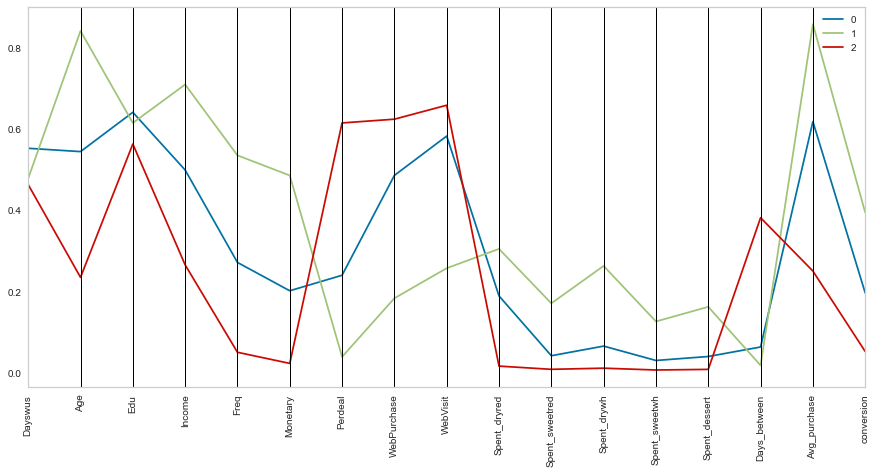

In [80]:
plt.figure(figsize=(15, 7))
pd.plotting.parallel_coordinates(kmeans_scaled_less, class_column = "analysis_labels", color=sns.color_palette())
plt.xticks(fontsize=10, rotation=90)
plt.show()


## Kmeans all variables

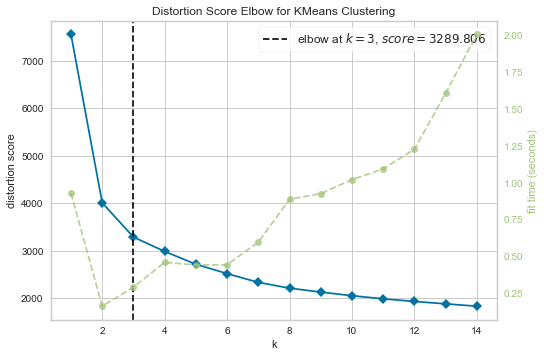

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [81]:
! pip install yellowbrick
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans

 

# Elbow Method for K means


inertia = KMeans(random_state=1, init='k-means++')


visualizer = KElbowVisualizer(inertia, k=(1,15), timings= True)
visualizer.fit(www_metric[metric_features])                           # Fit data to visualizer
visualizer.show() 

# Finalize and render figure

In [82]:
# final cluster solution
number_clusters = 3
kmclust = KMeans(n_clusters=number_clusters, init='k-means++', n_init=15, random_state=1)
km_labels = kmclust.fit_predict(www_metric)
km_labels

array([1, 2, 0, ..., 0, 0, 1])

In [83]:
www=df_2

In [84]:
# Characterizing the final clusters
www_metric['labels'] =km_labels
www['labels']=km_labels

In [85]:
www

,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend,conversion,Avg_purchase,Days_between,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Spent_exotic,analysis_labels,labels
Custid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5325,653,55,20,78473,0,0,20,18,826,445,7,36,5,0,0,0,0,0,0,0,0,0,0.08,41.30,27.00,553.42,33.04,214.76,16.52,8.26,8.26,0,1
3956,1041,75,18,105087,0,0,36,33,1852,539,2,20,4,0,0,0,1,0,0,0,0,0,0.10,51.44,15.00,907.48,0.00,851.92,18.52,55.56,0.00,1,2
3681,666,18,12,27984,1,0,4,56,39,-7,88,60,8,0,0,0,0,0,0,0,0,0,0.02,9.75,135.00,1.56,11.31,5.46,12.48,8.19,18.72,2,0
2829,1049,42,16,61748,1,1,2,46,37,-6,70,59,7,0,0,0,0,0,0,0,1,1,0.01,18.50,270.00,31.82,0.37,4.07,0.37,0.37,20.35,2,0
8788,837,47,16,65789,0,1,2,3,36,4,35,63,6,0,0,0,0,0,0,0,0,0,0.01,18.00,270.00,30.60,0.00,4.32,0.72,0.36,10.08,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1383,1132,57,20,81033,0,1,19,59,776,187,22,27,4,1,0,0,0,0,1,0,1,0,0.07,40.84,28.42,605.28,0.00,155.20,7.76,7.76,85.36,0,1
4070,596,66,15,84714,0,0,18,45,720,391,5,18,2,0,0,0,0,0,0,0,0,0,0.09,40.00,30.00,216.00,86.40,259.20,72.00,86.40,93.60,1,2
7909,619,18,12,40466,0,0,3,65,47,5,23,58,5,0,0,0,0,0,0,0,0,0,0.02,15.67,180.00,2.82,11.28,4.70,17.86,10.34,19.27,2,0


In [86]:
kmeans_scaled=www_metric.groupby('labels').mean()[metric_features]

In [87]:
kmeans_scaled=kmeans_scaled.reset_index()

In [88]:
kmeans_scaled

,labels,Dayswus,Age,Edu,Income,Freq,Monetary,Perdeal,WebPurchase,WebVisit,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Days_between,Avg_purchase,conversion
0,0,0.463415,0.235326,0.563249,0.266030,0.051041,0.023683,0.615078,0.624317,0.658668,0.017016,0.009110,0.011936,0.007446,0.008964,0.381969,0.250861,0.052988
1,1,0.552755,0.544593,0.641244,0.499385,0.271982,0.202311,0.240454,0.486035,0.582854,0.189576,0.042551,0.066221,0.030873,0.040672,0.064010,0.618309,0.197086
2,2,0.478570,0.841448,0.615007,0.709666,0.535354,0.485948,0.039793,0.183909,0.257832,0.305351,0.171405,0.263406,0.126790,0.162830,0.018776,0.858248,0.394769


In [89]:
www=pd.concat([preference_percentage,www], axis=1)

In [90]:
kmeans_not_scaled=www.groupby('labels').mean()
kmeans_not_scaled

,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend,conversion,Avg_purchase,Days_between,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Spent_exotic,analysis_labels
labels,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,44.462317,7.999467,31.120373,8.770706,7.628762,24.025033,874.390679,32.119574,16.505992,44512.089481,0.822636,0.460719,3.705193,80.116911,75.437816,-5.179228,59.662583,56.442610,6.586684,0.087084,0.006391,0.000000,0.001864,0.000266,0.093742,0.012517,0.143009,0.098802,0.017486,18.144160,212.443534,36.382549,5.129324,23.155758,5.700815,5.055148,16.416344,2
1,65.934547,4.253193,21.384100,4.306833,4.087165,12.710089,936.928161,50.675607,17.129949,74785.206258,0.251596,0.754789,15.415070,50.057471,599.175287,151.444764,23.324074,44.826948,5.828544,0.085568,0.106003,0.017561,0.035121,0.021711,0.230843,0.008301,0.088442,0.030651,0.065038,35.932353,43.925115,403.204725,23.957877,125.188908,23.636402,22.936453,69.153870,0
2,45.352179,7.019445,33.913216,7.065538,6.629456,7.960389,884.999280,68.486856,16.920058,102064.994959,0.038891,0.204537,29.373785,50.139359,1430.800864,576.206338,3.859921,19.448326,2.578322,0.072380,0.120274,0.270436,0.200216,0.021246,0.484336,0.011523,0.054735,0.001080,0.130274,47.547796,19.951372,649.316024,96.508145,495.817807,97.070263,91.826133,107.509273,1


In [91]:
kmeans_not_scaled[metric_features]

,Dayswus,Age,Edu,Income,Freq,Monetary,Perdeal,WebPurchase,WebVisit,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Days_between,Avg_purchase,conversion
labels,,,,,,,,,,,,,,,,,
0,874.390679,32.119574,16.505992,44512.089481,3.705193,75.437816,59.662583,56.442610,6.586684,36.382549,5.129324,23.155758,5.700815,5.055148,212.443534,18.144160,0.017486
1,936.928161,50.675607,17.129949,74785.206258,15.415070,599.175287,23.324074,44.826948,5.828544,403.204725,23.957877,125.188908,23.636402,22.936453,43.925115,35.932353,0.065038
2,884.999280,68.486856,16.920058,102064.994959,29.373785,1430.800864,3.859921,19.448326,2.578322,649.316024,96.508145,495.817807,97.070263,91.826133,19.951372,47.547796,0.130274


In [92]:
kmeans_not_scaled[socio]

,Age,Edu,Income
labels,,,
0,32.119574,16.505992,44512.089481
1,50.675607,17.129949,74785.206258
2,68.486856,16.920058,102064.994959


In [93]:
kmeans_not_scaled[cust_behavior]

,Dayswus,WebPurchase,WebVisit,Freq,Monetary,Perdeal,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Days_between,Avg_purchase,conversion
labels,,,,,,,,,,,,,,
0,874.390679,56.442610,6.586684,3.705193,75.437816,59.662583,36.382549,5.129324,23.155758,5.700815,5.055148,212.443534,18.144160,0.017486
1,936.928161,44.826948,5.828544,15.415070,599.175287,23.324074,403.204725,23.957877,125.188908,23.636402,22.936453,43.925115,35.932353,0.065038
2,884.999280,19.448326,2.578322,29.373785,1430.800864,3.859921,649.316024,96.508145,495.817807,97.070263,91.826133,19.951372,47.547796,0.130274


In [94]:
kmeans_not_scaled=kmeans_not_scaled.reset_index()

In [95]:
#size of the clusters
df_counts = www.groupby('labels')\
.size()\
.to_frame()

In [96]:
df_counts.rename(columns={0: "Size"},inplace=True)
df_counts

,Size
labels,
0,3755
1,3132
2,2777


In [97]:

# using R^2
def get_ss(df):
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  
sst = get_ss(www_metric[metric_features]) 
ssw_labels = www_metric[metric_features + ["labels"]].groupby(by='labels').apply(get_ss)  
ssb = sst - np.sum(ssw_labels)  
r2_kmeans = ssb / sst
r2_kmeans

0.5594988788309158

In [98]:
#using davies bouldin index
davies_bouldin_score(www_metric[metric_features], km_labels)

1.3397519837163692

In [99]:
davies_bouldin=davies_bouldin_score(www_metric[metric_features],km_labels)

In [100]:
#using calinski_harabasz
metrics.calinski_harabasz_score(www_metric[metric_features], km_labels)

6135.4198759355595

In [101]:
calinski_harabasz=metrics.calinski_harabasz_score(www_metric[metric_features], km_labels)

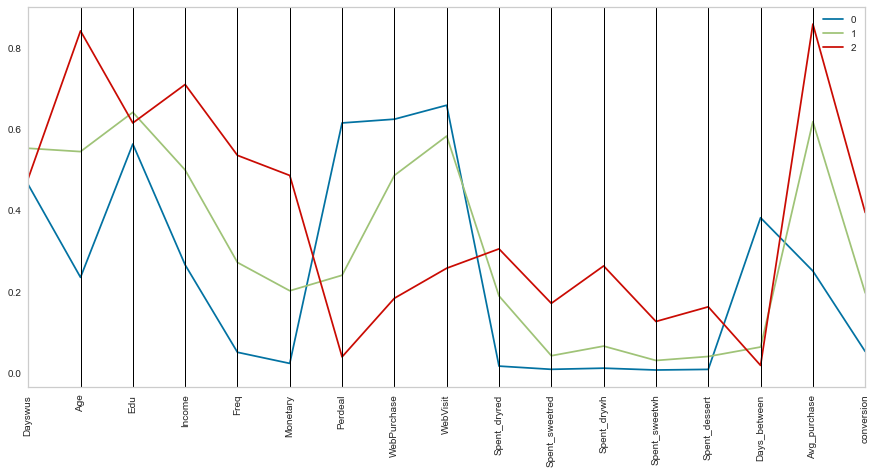

In [102]:
plt.figure(figsize=(15, 7))
pd.plotting.parallel_coordinates(kmeans_scaled, class_column = "labels", color=sns.color_palette())
plt.xticks(fontsize=10, rotation=90)
plt.show()


# By perspective 

In [103]:
#creation of the dataset corrsponding to each perspective
cluster_socio=www_metric[socio]
cluster_behavior=www_metric[cust_behavior]

# Socio demographic perspective

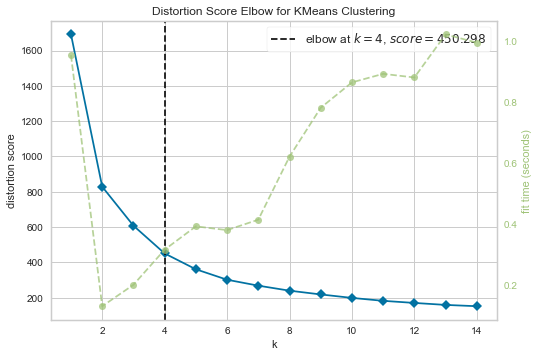

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [104]:
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans


# Elbow Method for K means


inertia = KMeans(random_state=1, init='k-means++')


visualizer = KElbowVisualizer(inertia, k=(1,15), timings= True)
visualizer.fit(cluster_socio)                           # Fit data to visualizer
visualizer.show() 

# Finalize and render figure

In [105]:
# final cluster solution
number_clusters = 4
kmclust = KMeans(n_clusters=number_clusters, init='k-means++', n_init=15, random_state=1)
km_labels_socio = kmclust.fit_predict(cluster_socio)
km_labels_socio

array([0, 0, 2, ..., 2, 2, 1])

In [106]:
www=df_2

In [107]:
# Characterizing the final clusters
www_metric['socio_labels'] =km_labels_socio

www['socio_labels']=km_labels_socio


In [108]:
www.groupby('socio_labels').mean()[socio]

,Age,Edu,Income
socio_labels,,,
0,66.027570,18.444860,97884.474766
1,60.928819,15.479030,89770.317045
2,30.010284,15.241053,42273.694364
3,38.855253,18.390136,55834.591820


In [109]:
www.groupby('socio_labels').mean()

,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend,conversion,Avg_purchase,Days_between,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Spent_exotic,analysis_labels,labels
socio_labels,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,892.428037,66.027570,18.444860,97884.474766,0.098131,0.364486,26.564486,50.381776,1261.256542,485.215888,7.889720,25.292523,3.329439,0.071963,0.112150,0.208879,0.166355,0.022430,0.415421,0.011215,0.057009,0.006542,0.116495,45.290075,24.415444,694.053519,55.605285,402.770280,54.345729,54.166841,71.341304,0.694860,1.687850
1,897.580993,60.928819,15.479030,89770.317045,0.122355,0.559061,21.968834,50.810312,992.549057,354.019623,14.191227,32.157753,4.098499,0.064255,0.122355,0.136206,0.110042,0.020392,0.343209,0.010004,0.068488,0.011543,0.096376,41.395410,37.102940,457.288188,78.495406,303.343305,79.407791,73.812813,108.573167,0.582532,1.456714
2,897.719457,30.010284,15.241053,42273.694364,0.772933,0.357055,4.736323,78.316331,116.182230,4.882353,55.642123,56.141917,6.735911,0.099959,0.007404,0.000000,0.002879,0.000823,0.108186,0.009461,0.153435,0.101604,0.021189,19.316392,193.418568,49.700095,9.847084,36.349329,11.066861,9.218474,29.776142,1.763883,0.118058
3,902.355253,38.855253,18.390136,55834.591820,0.632719,0.625902,7.339615,66.798717,229.373296,33.951083,47.622294,52.992382,6.413793,0.093023,0.045710,0.002005,0.009623,0.010024,0.150762,0.012831,0.117482,0.071772,0.032013,24.557378,149.087314,163.599362,6.157446,47.010710,6.181091,6.276492,27.886403,1.202085,0.401363


In [110]:
#size of the clusters
df_counts = www.groupby('socio_labels')\
.size()\
.to_frame()

In [111]:
df_counts.rename(columns={0: "Size"},inplace=True)
df_counts

,Size
socio_labels,
0,2140
1,2599
2,2431
3,2494


In [112]:
# using R^2
def get_ss(df):
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  
sst = get_ss(cluster_socio) 
ssw_labels = www_metric[socio + ["socio_labels"]].groupby(by='socio_labels').apply(get_ss)  
ssb = sst - np.sum(ssw_labels)  
r2_kmeans_socio = ssb / sst
r2_kmeans_socio

0.7337698164617773

In [113]:
www_metric

,Age,Edu,Income,Dayswus,WebPurchase,WebVisit,Access,Freq,Recency,Monetary,LTV,Perdeal,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Spent_exotic,Days_between,Avg_purchase,conversion,analysis_labels,labels,socio_labels
0,0.616667,1.000,0.527812,0.147143,0.380952,0.5,0.000000,0.358491,0.032787,0.279673,0.385520,0.072165,0.260240,0.058681,0.113875,0.021578,0.014647,0.006177,0.032075,0.729188,0.242424,0,1,0
1,0.950000,0.750,0.732961,0.701429,0.190476,0.4,0.000000,0.660377,0.060109,0.629604,0.443688,0.020619,0.426796,0.000000,0.452862,0.024190,0.098521,0.000000,0.009434,0.938649,0.303030,1,2,0
2,0.000000,0.000,0.138626,0.165714,0.666667,0.8,0.000000,0.056604,0.102004,0.011255,0.105817,0.907216,0.000635,0.020087,0.002522,0.016301,0.014523,0.013999,0.235849,0.077463,0.060606,2,0,2
3,0.400000,0.500,0.398890,0.712857,0.654762,0.7,0.000000,0.018868,0.083789,0.010573,0.106436,0.721649,0.014870,0.000657,0.001782,0.000483,0.000656,0.015218,0.490566,0.258211,0.030303,2,0,2
4,0.483333,0.500,0.430039,0.410000,0.702381,0.6,0.000000,0.018868,0.005464,0.010232,0.112624,0.360825,0.014296,0.000000,0.001915,0.000940,0.000638,0.007538,0.490566,0.247883,0.030303,2,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9659,0.650000,1.000,0.547545,0.831429,0.273810,0.4,0.333333,0.339623,0.107468,0.262619,0.225866,0.226804,0.284636,0.000000,0.082188,0.010136,0.013760,0.063834,0.034755,0.719686,0.212121,0,1,0
9660,0.800000,0.375,0.575919,0.065714,0.166667,0.2,0.000000,0.320755,0.081967,0.243520,0.352104,0.051546,0.101511,0.153453,0.137519,0.094044,0.153208,0.069996,0.037736,0.702334,0.272727,1,2,1
9661,0.000000,0.000,0.234842,0.098571,0.642857,0.5,0.000000,0.037736,0.118397,0.013984,0.113243,0.237113,0.001228,0.020034,0.002117,0.023328,0.018335,0.014410,0.320755,0.199752,0.060606,2,0,2
9662,0.250000,0.500,0.336553,0.795714,0.666667,0.6,0.000000,0.000000,0.670310,0.003070,0.111386,0.360825,0.001171,0.003463,0.003208,0.002155,0.003458,0.001458,1.000000,0.185912,0.030303,2,0,2


In [114]:
# to get the dataset without the obtained labels 
www_metric_nolabels=www_metric.iloc[:,:-2]

In [115]:
www_metric_nolabels

,Age,Edu,Income,Dayswus,WebPurchase,WebVisit,Access,Freq,Recency,Monetary,LTV,Perdeal,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Spent_exotic,Days_between,Avg_purchase,conversion,analysis_labels
0,0.616667,1.000,0.527812,0.147143,0.380952,0.5,0.000000,0.358491,0.032787,0.279673,0.385520,0.072165,0.260240,0.058681,0.113875,0.021578,0.014647,0.006177,0.032075,0.729188,0.242424,0
1,0.950000,0.750,0.732961,0.701429,0.190476,0.4,0.000000,0.660377,0.060109,0.629604,0.443688,0.020619,0.426796,0.000000,0.452862,0.024190,0.098521,0.000000,0.009434,0.938649,0.303030,1
2,0.000000,0.000,0.138626,0.165714,0.666667,0.8,0.000000,0.056604,0.102004,0.011255,0.105817,0.907216,0.000635,0.020087,0.002522,0.016301,0.014523,0.013999,0.235849,0.077463,0.060606,2
3,0.400000,0.500,0.398890,0.712857,0.654762,0.7,0.000000,0.018868,0.083789,0.010573,0.106436,0.721649,0.014870,0.000657,0.001782,0.000483,0.000656,0.015218,0.490566,0.258211,0.030303,2
4,0.483333,0.500,0.430039,0.410000,0.702381,0.6,0.000000,0.018868,0.005464,0.010232,0.112624,0.360825,0.014296,0.000000,0.001915,0.000940,0.000638,0.007538,0.490566,0.247883,0.030303,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9659,0.650000,1.000,0.547545,0.831429,0.273810,0.4,0.333333,0.339623,0.107468,0.262619,0.225866,0.226804,0.284636,0.000000,0.082188,0.010136,0.013760,0.063834,0.034755,0.719686,0.212121,0
9660,0.800000,0.375,0.575919,0.065714,0.166667,0.2,0.000000,0.320755,0.081967,0.243520,0.352104,0.051546,0.101511,0.153453,0.137519,0.094044,0.153208,0.069996,0.037736,0.702334,0.272727,1
9661,0.000000,0.000,0.234842,0.098571,0.642857,0.5,0.000000,0.037736,0.118397,0.013984,0.113243,0.237113,0.001228,0.020034,0.002117,0.023328,0.018335,0.014410,0.320755,0.199752,0.060606,2
9662,0.250000,0.500,0.336553,0.795714,0.666667,0.6,0.000000,0.000000,0.670310,0.003070,0.111386,0.360825,0.001171,0.003463,0.003208,0.002155,0.003458,0.001458,1.000000,0.185912,0.030303,2


In [116]:
# to define the labels serie
socio_labels=www_metric.iloc[:,-1:]

In [117]:
#using davies bouldin index
davies_bouldin_score(cluster_socio, socio_labels)

D:\gftou\Anaconda\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


0.985940863967781

In [118]:
davies_bouldin_socio=davies_bouldin_score(cluster_socio, socio_labels)

D:\gftou\Anaconda\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


In [119]:
#using calinski_harabasz
metrics.calinski_harabasz_score(cluster_socio, socio_labels)

D:\gftou\Anaconda\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


8874.796905466723

In [120]:
calinski_harabasz_socio=metrics.calinski_harabasz_score(cluster_socio, socio_labels)

D:\gftou\Anaconda\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


# Behavior perspective

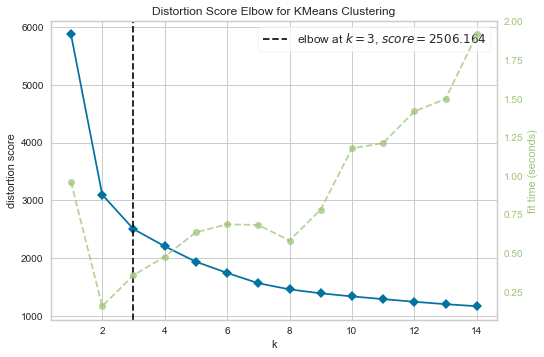

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [121]:
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans

 

# Elbow Method for K means

inertia = KMeans(random_state=1, init='k-means++')

visualizer = KElbowVisualizer(inertia, k=(1,15), timings= True)
visualizer.fit(cluster_behavior)                           # Fit data to visualizer
visualizer.show() 

# Finalize and render figure

In [122]:
# final cluster solution
number_clusters = 5
kmclust = KMeans(n_clusters=number_clusters, init='k-means++', n_init=15, random_state=1)
km_labels_behav = kmclust.fit_predict(cluster_behavior)
km_labels_behav

array([4, 2, 0, ..., 0, 0, 1])

In [123]:
# Characterizing the final clusters
www_metric['behav_labels'] =km_labels_behav
www['behav_labels']=km_labels_behav


In [124]:
www.groupby('behav_labels').mean()[cust_behavior]

,Dayswus,WebPurchase,WebVisit,Freq,Monetary,Perdeal,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Days_between,Avg_purchase,conversion
behav_labels,,,,,,,,,,,,,,
0,748.761278,55.930451,6.019267,2.767387,44.500000,59.437500,21.747575,3.148806,13.256330,3.325611,3.009798,264.453327,15.728722,0.014652
1,1074.343119,41.258104,6.085627,22.376758,989.385933,16.441590,650.039199,43.216336,212.868410,41.633529,41.250679,25.886881,42.973627,0.083841
2,883.531415,16.565468,2.261871,31.628297,1572.238849,2.316067,679.396628,107.869199,573.722427,108.437981,102.562082,17.848374,49.078916,0.139065
3,1061.709154,56.343504,7.324803,6.188484,164.926181,56.668307,93.064867,8.444464,45.138622,9.624759,8.597475,125.542849,23.369587,0.026038
4,743.255605,39.709641,4.366031,12.762892,452.707399,19.315583,273.465000,24.032511,107.480561,24.776609,22.790639,52.301138,33.162859,0.067270


In [125]:
www.groupby('behav_labels').mean()

,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend,conversion,Avg_purchase,Days_between,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Spent_exotic,analysis_labels,labels,socio_labels
behav_labels,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,748.761278,32.581297,16.539944,44543.593985,0.807801,0.480733,2.767387,99.082237,44.500000,-2.891447,59.437500,55.930451,6.019267,0.082237,0.003759,0.000000,0.000940,0.000470,0.086466,0.012688,0.147086,0.091165,0.014652,15.728722,264.453327,21.747575,3.148806,13.256330,3.325611,3.009798,9.801010,1.989662,0.005169,2.370771
1,1074.343119,54.935780,17.040367,82745.840367,0.188379,0.718654,22.376758,50.474618,989.385933,302.968196,16.441590,41.258104,6.085627,0.100306,0.144343,0.060550,0.069113,0.033639,0.338838,0.011621,0.082569,0.018349,0.083841,42.973627,25.886881,650.039199,43.216336,212.868410,41.633529,41.250679,104.393896,0.219572,1.219572,1.098471
2,883.531415,70.126139,16.958273,105046.529976,0.017266,0.081055,31.628297,50.410552,1572.238849,645.085851,2.316067,16.565468,2.261871,0.072422,0.128058,0.329017,0.240288,0.025420,0.554916,0.010072,0.052278,0.000959,0.139065,49.078916,17.848374,679.396628,107.869199,573.722427,108.437981,102.562082,111.319923,1.000000,2.000000,0.442686
3,1061.709154,34.205217,16.625492,48138.438484,0.781496,0.514764,6.188484,53.497539,164.926181,-4.006890,56.668307,56.343504,7.324803,0.094980,0.017224,0.000000,0.003445,0.000984,0.113189,0.011319,0.129921,0.097933,0.026038,23.369587,125.542849,93.064867,8.444464,45.138622,9.624759,8.597475,31.225276,1.524606,0.237697,2.363189
4,743.255605,53.050448,17.051009,77290.983184,0.187220,0.700112,12.762892,50.263453,452.707399,128.329596,19.315583,39.709641,4.366031,0.063341,0.080717,0.011771,0.028027,0.009529,0.165359,0.008408,0.081278,0.025224,0.067270,33.162859,52.301138,273.465000,24.032511,107.480561,24.776609,22.790639,50.277001,0.286435,1.136771,1.332399


In [126]:
df_counts = www.groupby('behav_labels')\
.size()\
.to_frame()

In [127]:
df_counts.rename(columns={0: "Size"},inplace=True)
df_counts

,Size
behav_labels,
0,2128
1,1635
2,2085
3,2032
4,1784


In [128]:
# using R^2
def get_ss(df):
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  
sst = get_ss(cluster_behavior) 
ssw_labels = www_metric[cust_behavior + ["behav_labels"]].groupby(by='behav_labels').apply(get_ss)  
ssb = sst - np.sum(ssw_labels)  
r2_kmeans_behav = ssb / sst
r2_kmeans_behav

0.6692013179916078

In [129]:
www_metric

,Age,Edu,Income,Dayswus,WebPurchase,WebVisit,Access,Freq,Recency,Monetary,LTV,Perdeal,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Spent_exotic,Days_between,Avg_purchase,conversion,analysis_labels,labels,socio_labels,behav_labels
0,0.616667,1.000,0.527812,0.147143,0.380952,0.5,0.000000,0.358491,0.032787,0.279673,0.385520,0.072165,0.260240,0.058681,0.113875,0.021578,0.014647,0.006177,0.032075,0.729188,0.242424,0,1,0,4
1,0.950000,0.750,0.732961,0.701429,0.190476,0.4,0.000000,0.660377,0.060109,0.629604,0.443688,0.020619,0.426796,0.000000,0.452862,0.024190,0.098521,0.000000,0.009434,0.938649,0.303030,1,2,0,2
2,0.000000,0.000,0.138626,0.165714,0.666667,0.8,0.000000,0.056604,0.102004,0.011255,0.105817,0.907216,0.000635,0.020087,0.002522,0.016301,0.014523,0.013999,0.235849,0.077463,0.060606,2,0,2,0
3,0.400000,0.500,0.398890,0.712857,0.654762,0.7,0.000000,0.018868,0.083789,0.010573,0.106436,0.721649,0.014870,0.000657,0.001782,0.000483,0.000656,0.015218,0.490566,0.258211,0.030303,2,0,2,3
4,0.483333,0.500,0.430039,0.410000,0.702381,0.6,0.000000,0.018868,0.005464,0.010232,0.112624,0.360825,0.014296,0.000000,0.001915,0.000940,0.000638,0.007538,0.490566,0.247883,0.030303,2,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9659,0.650000,1.000,0.547545,0.831429,0.273810,0.4,0.333333,0.339623,0.107468,0.262619,0.225866,0.226804,0.284636,0.000000,0.082188,0.010136,0.013760,0.063834,0.034755,0.719686,0.212121,0,1,0,1
9660,0.800000,0.375,0.575919,0.065714,0.166667,0.2,0.000000,0.320755,0.081967,0.243520,0.352104,0.051546,0.101511,0.153453,0.137519,0.094044,0.153208,0.069996,0.037736,0.702334,0.272727,1,2,1,4
9661,0.000000,0.000,0.234842,0.098571,0.642857,0.5,0.000000,0.037736,0.118397,0.013984,0.113243,0.237113,0.001228,0.020034,0.002117,0.023328,0.018335,0.014410,0.320755,0.199752,0.060606,2,0,2,0
9662,0.250000,0.500,0.336553,0.795714,0.666667,0.6,0.000000,0.000000,0.670310,0.003070,0.111386,0.360825,0.001171,0.003463,0.003208,0.002155,0.003458,0.001458,1.000000,0.185912,0.030303,2,0,2,0


In [130]:
# to get the dataset without the obtained labels 
www_metric_behav_nolabels=www_metric.iloc[:,:-3]

In [131]:
www_metric_behav_nolabels

,Age,Edu,Income,Dayswus,WebPurchase,WebVisit,Access,Freq,Recency,Monetary,LTV,Perdeal,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Spent_exotic,Days_between,Avg_purchase,conversion,analysis_labels
0,0.616667,1.000,0.527812,0.147143,0.380952,0.5,0.000000,0.358491,0.032787,0.279673,0.385520,0.072165,0.260240,0.058681,0.113875,0.021578,0.014647,0.006177,0.032075,0.729188,0.242424,0
1,0.950000,0.750,0.732961,0.701429,0.190476,0.4,0.000000,0.660377,0.060109,0.629604,0.443688,0.020619,0.426796,0.000000,0.452862,0.024190,0.098521,0.000000,0.009434,0.938649,0.303030,1
2,0.000000,0.000,0.138626,0.165714,0.666667,0.8,0.000000,0.056604,0.102004,0.011255,0.105817,0.907216,0.000635,0.020087,0.002522,0.016301,0.014523,0.013999,0.235849,0.077463,0.060606,2
3,0.400000,0.500,0.398890,0.712857,0.654762,0.7,0.000000,0.018868,0.083789,0.010573,0.106436,0.721649,0.014870,0.000657,0.001782,0.000483,0.000656,0.015218,0.490566,0.258211,0.030303,2
4,0.483333,0.500,0.430039,0.410000,0.702381,0.6,0.000000,0.018868,0.005464,0.010232,0.112624,0.360825,0.014296,0.000000,0.001915,0.000940,0.000638,0.007538,0.490566,0.247883,0.030303,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9659,0.650000,1.000,0.547545,0.831429,0.273810,0.4,0.333333,0.339623,0.107468,0.262619,0.225866,0.226804,0.284636,0.000000,0.082188,0.010136,0.013760,0.063834,0.034755,0.719686,0.212121,0
9660,0.800000,0.375,0.575919,0.065714,0.166667,0.2,0.000000,0.320755,0.081967,0.243520,0.352104,0.051546,0.101511,0.153453,0.137519,0.094044,0.153208,0.069996,0.037736,0.702334,0.272727,1
9661,0.000000,0.000,0.234842,0.098571,0.642857,0.5,0.000000,0.037736,0.118397,0.013984,0.113243,0.237113,0.001228,0.020034,0.002117,0.023328,0.018335,0.014410,0.320755,0.199752,0.060606,2
9662,0.250000,0.500,0.336553,0.795714,0.666667,0.6,0.000000,0.000000,0.670310,0.003070,0.111386,0.360825,0.001171,0.003463,0.003208,0.002155,0.003458,0.001458,1.000000,0.185912,0.030303,2


In [132]:
# to define the labels serie
behav_labels=www_metric.iloc[:,-1:]

In [133]:
#using davies bouldin index
davies_bouldin_score(cluster_behavior, behav_labels)

D:\gftou\Anaconda\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


1.3345671937197676

In [134]:
davies_bouldin_behav=davies_bouldin_score(cluster_behavior, behav_labels)

D:\gftou\Anaconda\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


In [135]:
#using calinski_harabasz
metrics.calinski_harabasz_score(cluster_behavior, behav_labels)

D:\gftou\Anaconda\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


4885.007016379962

In [136]:
calinski_harabasz_behav=metrics.calinski_harabasz_score(cluster_behavior, behav_labels)

D:\gftou\Anaconda\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


# Merging

In [137]:
# count label frequencies (contigency table)
www_metric.groupby(['socio_labels', 'behav_labels'])\
    .size()\
    .to_frame()\
    .reset_index()\
    .pivot('socio_labels','behav_labels', 0)

behav_labels,0,1,2,3,4
socio_labels,,,,,
0,4.0,511.0,1166.0,11.0,448.0
1,73.0,746.0,917.0,114.0,749.0
2,1181.0,84.0,NaN,1033.0,133.0
3,870.0,294.0,2.0,874.0,454.0


In [138]:
# Percentage
www_metric.groupby(['socio_labels','behav_labels'])\
    .size()\
    .to_frame()\
    .reset_index()\
    .pivot('socio_labels','behav_labels', 0).div(len(www.index)).mul(100)

behav_labels,0,1,2,3,4
socio_labels,,,,,
0,0.041391,5.287666,12.065397,0.113825,4.635762
1,0.755381,7.719371,9.488825,1.179636,7.750414
2,12.220613,0.869205,NaN,10.689156,1.376242
3,9.002483,3.042219,0.020695,9.043874,4.697848


In [139]:
# centroids of the concatenated cluster labels
df_centroids = www_metric.groupby(['socio_labels', 'behav_labels'])\
    [metric_features].mean()
df_centroids

Dayswus       Age       Edu    Income      Freq  \
socio_labels behav_labels                                                     
0            0             0.157857  0.608333  0.843750  0.514118  0.018868   
             1             0.726094  0.717254  0.828767  0.622938  0.452719   
             2             0.477679  0.874728  0.787093  0.736266  0.583304   
             3             0.634805  0.616667  0.784091  0.511026  0.171527   
             4             0.248278  0.708296  0.827567  0.592052  0.265162   
1            0             0.201683  0.545434  0.448630  0.450337  0.044197   
             1             0.748545  0.648146  0.456099  0.579020  0.409606   
             2             0.474811  0.862123  0.406761  0.728386  0.571285   
             3             0.668659  0.538012  0.421053  0.469196  0.158557   
             4             0.274703  0.646595  0.448932  0.549893  0.237020   
2            0             0.287258  0.184194  0.403260  0.228027  0.032272   
             1             0.795051  0.310119  0.386905  0.391836  0.304358   
             3             0.735929  0.197596  0.407430  0.245221  0.084056   
             4             0.310752  0.292607  0.415414  0.370278  0.156902   
3            0             0.286929  0.295824  0.799138  0.301607  0.033962   
             1             0.777153  0.443594  0.795493  0.454553  0.329868   
             2             0.535714  0.441667  0.750000  0.578220  0.452830   
             3             0.734547  0.316457  0.797912  0.326031  0.105414   
             4             0.295626  0.444126  0.802037  0.438337  0.173469   

                           Monetary   Perdeal  WebPurchase  WebVisit  \
socio_labels behav_labels                                              
0            0             0.011426  0.502577     0.514881  0.400000   
             1             0.390846  0.133839     0.400848  0.564775   
             2             0.540371  0.022537     0.144491  0.219897   
             3             0.103714  0.552015     0.517316  0.590909   
             4             0.190181  0.159172     0.360252  0.355804   
1            0             0.022150  0.485383     0.540280  0.469863   
             1             0.341964  0.168307     0.434875  0.590080   
             2             0.526642  0.025576     0.155710  0.233915   
             3             0.096961  0.492313     0.569549  0.644737   
             4             0.165281  0.186475     0.400057  0.404139   
2            0             0.011784  0.615833     0.627636  0.618036   
             1             0.226998  0.224595     0.509070  0.697619   
             3             0.044204  0.597279     0.635862  0.750436   
             4             0.095544  0.235641     0.512531  0.554887   
3            0             0.014210  0.619777     0.612452  0.592069   
             1             0.253333  0.218774     0.521056  0.706122   
             2             0.388813  0.025773     0.315476  0.350000   
             3             0.059824  0.581153     0.616419  0.724485   
             4             0.110349  0.248740     0.504851  0.535242   

                           Spent_dryred  Spent_sweetred  Spent_drywh  \
socio_labels behav_labels                                              
0            0                 0.013487        0.002127     0.003212   
             1                 0.377905        0.062747     0.128865   
             2                 0.367532        0.137827     0.308228   
             3                 0.100740        0.023321     0.032010   
             4                 0.168915        0.040870     0.071745   
1            0                 0.021428        0.005884     0.007358   
             1                 0.289404        0.100718     0.120758   
             2                 0.258620        0.260266     0.300777   
             3                 0.090715        0.022528     0.030965   
             4                 0.125335        0.060799     0.0

In [140]:
#  Hierarchical clustering to merge the concatenated cluster centroids
hclust = AgglomerativeClustering(
    linkage='ward', 
    affinity='euclidean', 
    distance_threshold=0, 
    n_clusters=None
)
hclust_labels = hclust.fit_predict(df_centroids)

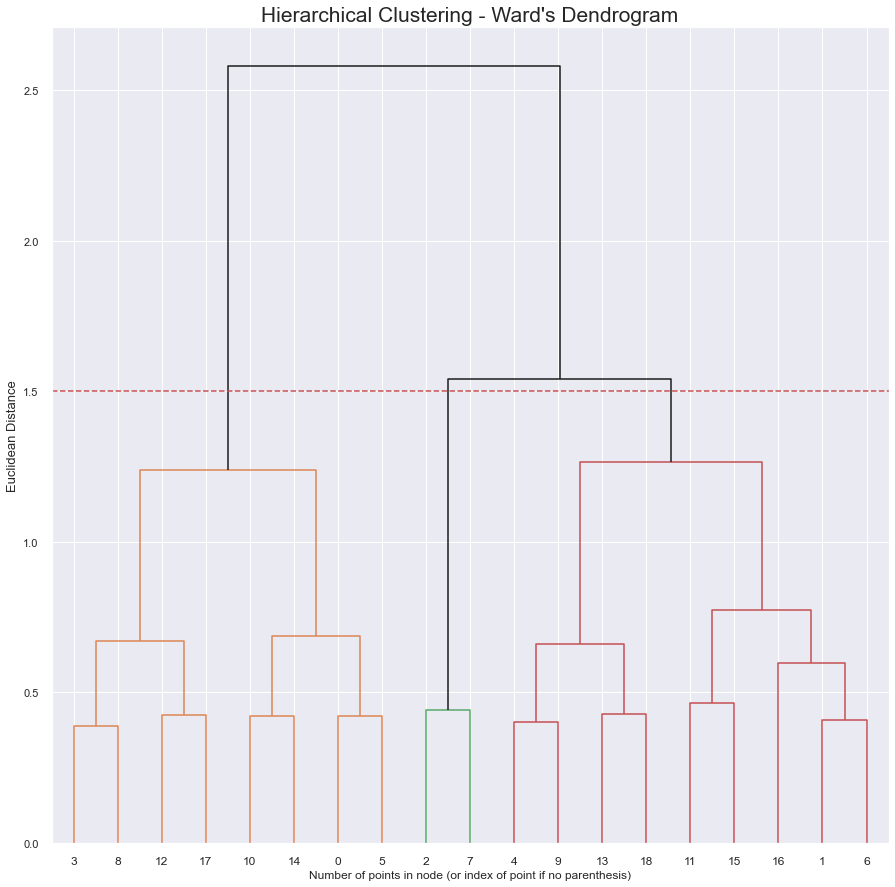

In [141]:
#dendogram
linkage = 'ward'
distance = 'euclidean'

counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)


for i, merge in enumerate(hclust.children_):
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            current_count += 1  
        else:
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

sns.set()
fig = plt.figure(figsize=(15,15))

y_threshold = 1.5
dendrogram(linkage_matrix, truncate_mode='level', p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering - {linkage.title()}\'s Dendrogram', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'{distance.title()} Distance', fontsize=13)
plt.show()


In [142]:
# re-running the Hierarchical clustering based on the correct number of clusters
hclust = AgglomerativeClustering(
    linkage='ward', 
    affinity='euclidean', 
    n_clusters=3
)
hclust_labels = hclust.fit_predict(df_centroids)
df_centroids['hclust_labels'] = hclust_labels

df_centroids 

Dayswus       Age       Edu    Income      Freq  \
socio_labels behav_labels                                                     
0            0             0.157857  0.608333  0.843750  0.514118  0.018868   
             1             0.726094  0.717254  0.828767  0.622938  0.452719   
             2             0.477679  0.874728  0.787093  0.736266  0.583304   
             3             0.634805  0.616667  0.784091  0.511026  0.171527   
             4             0.248278  0.708296  0.827567  0.592052  0.265162   
1            0             0.201683  0.545434  0.448630  0.450337  0.044197   
             1             0.748545  0.648146  0.456099  0.579020  0.409606   
             2             0.474811  0.862123  0.406761  0.728386  0.571285   
             3             0.668659  0.538012  0.421053  0.469196  0.158557   
             4             0.274703  0.646595  0.448932  0.549893  0.237020   
2            0             0.287258  0.184194  0.403260  0.228027  0.032272   
             1             0.795051  0.310119  0.386905  0.391836  0.304358   
             3             0.735929  0.197596  0.407430  0.245221  0.084056   
             4             0.310752  0.292607  0.415414  0.370278  0.156902   
3            0             0.286929  0.295824  0.799138  0.301607  0.033962   
             1             0.777153  0.443594  0.795493  0.454553  0.329868   
             2             0.535714  0.441667  0.750000  0.578220  0.452830   
             3             0.734547  0.316457  0.797912  0.326031  0.105414   
             4             0.295626  0.444126  0.802037  0.438337  0.173469   

                           Monetary   Perdeal  WebPurchase  WebVisit  \
socio_labels behav_labels                                              
0            0             0.011426  0.502577     0.514881  0.400000   
             1             0.390846  0.133839     0.400848  0.564775   
             2             0.540371  0.022537     0.144491  0.219897   
             3             0.103714  0.552015     0.517316  0.590909   
             4             0.190181  0.159172     0.360252  0.355804   
1            0             0.022150  0.485383     0.540280  0.469863   
             1             0.341964  0.168307     0.434875  0.590080   
             2             0.526642  0.025576     0.155710  0.233915   
             3             0.096961  0.492313     0.569549  0.644737   
             4             0.165281  0.186475     0.400057  0.404139   
2            0             0.011784  0.615833     0.627636  0.618036   
             1             0.226998  0.224595     0.509070  0.697619   
             3             0.044204  0.597279     0.635862  0.750436   
             4             0.095544  0.235641     0.512531  0.554887   
3            0             0.014210  0.619777     0.612452  0.592069   
             1             0.253333  0.218774     0.521056  0.706122   
             2             0.388813  0.025773     0.315476  0.350000   
             3             0.059824  0.581153     0.616419  0.724485   
             4             0.110349  0.248740     0.504851  0.535242   

                           Spent_dryred  Spent_sweetred  Spent_drywh  \
socio_labels behav_labels                                              
0            0                 0.013487        0.002127     0.003212   
             1                 0.377905        0.062747     0.128865   
             2                 0.367532        0.137827     0.308228   
             3                 0.100740        0.023321     0.032010   
             4                 0.168915        0.040870     0.071745   
1            0                 0.021428        0.005884     0.007358   
             1                 0.289404        0.100718     0.120758   
             2                 0.258620        0.260266     0.300777   
             3                 0.090715        0.022528     0.030965   
             4                 0.125335        0.060799     0.0

In [143]:
# mapper between concatenated clusters and hierarchical clusters
cluster_mapper = df_centroids['hclust_labels'].to_dict()

df_ = www_metric.copy()

# mapping the hierarchical clusters on the centroids to the observations
df_['merged_labels'] = df_.apply(
    lambda row: cluster_mapper[
        (row['socio_labels'], row['behav_labels'])
    ], axis=1
)

# merged cluster centroids
df_.groupby('merged_labels').mean()[metric_features]

,Dayswus,Age,Edu,Income,Freq,Monetary,Perdeal,WebPurchase,WebVisit,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Days_between,Avg_purchase,conversion
merged_labels,,,,,,,,,,,,,,,,,
0,0.502284,0.599108,0.630810,0.538831,0.308770,0.239975,0.184868,0.433861,0.518737,0.213268,0.058966,0.083685,0.042928,0.056207,0.055960,0.658111,0.227942
1,0.502320,0.256242,0.572716,0.279808,0.064877,0.033194,0.598813,0.620622,0.665697,0.026519,0.010187,0.014955,0.008363,0.010177,0.352077,0.278062,0.061254
2,0.476417,0.869179,0.619659,0.732797,0.578012,0.534327,0.023875,0.149430,0.226068,0.319586,0.191728,0.304948,0.141674,0.181758,0.014801,0.889941,0.421464


In [144]:
df_

,Age,Edu,Income,Dayswus,WebPurchase,WebVisit,Access,Freq,Recency,Monetary,LTV,Perdeal,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Spent_exotic,Days_between,Avg_purchase,conversion,analysis_labels,labels,socio_labels,behav_labels,merged_labels
0,0.616667,1.000,0.527812,0.147143,0.380952,0.5,0.000000,0.358491,0.032787,0.279673,0.385520,0.072165,0.260240,0.058681,0.113875,0.021578,0.014647,0.006177,0.032075,0.729188,0.242424,0,1,0,4,0
1,0.950000,0.750,0.732961,0.701429,0.190476,0.4,0.000000,0.660377,0.060109,0.629604,0.443688,0.020619,0.426796,0.000000,0.452862,0.024190,0.098521,0.000000,0.009434,0.938649,0.303030,1,2,0,2,2
2,0.000000,0.000,0.138626,0.165714,0.666667,0.8,0.000000,0.056604,0.102004,0.011255,0.105817,0.907216,0.000635,0.020087,0.002522,0.016301,0.014523,0.013999,0.235849,0.077463,0.060606,2,0,2,0,1
3,0.400000,0.500,0.398890,0.712857,0.654762,0.7,0.000000,0.018868,0.083789,0.010573,0.106436,0.721649,0.014870,0.000657,0.001782,0.000483,0.000656,0.015218,0.490566,0.258211,0.030303,2,0,2,3,1
4,0.483333,0.500,0.430039,0.410000,0.702381,0.6,0.000000,0.018868,0.005464,0.010232,0.112624,0.360825,0.014296,0.000000,0.001915,0.000940,0.000638,0.007538,0.490566,0.247883,0.030303,2,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9659,0.650000,1.000,0.547545,0.831429,0.273810,0.4,0.333333,0.339623,0.107468,0.262619,0.225866,0.226804,0.284636,0.000000,0.082188,0.010136,0.013760,0.063834,0.034755,0.719686,0.212121,0,1,0,1,0
9660,0.800000,0.375,0.575919,0.065714,0.166667,0.2,0.000000,0.320755,0.081967,0.243520,0.352104,0.051546,0.101511,0.153453,0.137519,0.094044,0.153208,0.069996,0.037736,0.702334,0.272727,1,2,1,4,0
9661,0.000000,0.000,0.234842,0.098571,0.642857,0.5,0.000000,0.037736,0.118397,0.013984,0.113243,0.237113,0.001228,0.020034,0.002117,0.023328,0.018335,0.014410,0.320755,0.199752,0.060606,2,0,2,0,1
9662,0.250000,0.500,0.336553,0.795714,0.666667,0.6,0.000000,0.000000,0.670310,0.003070,0.111386,0.360825,0.001171,0.003463,0.003208,0.002155,0.003458,0.001458,1.000000,0.185912,0.030303,2,0,2,0,1


In [145]:
#creating the dataset without the labels
df_nolabels=df_.iloc[:,:-4]

merged_labels=df_.iloc[:,-1:]

In [146]:
www["merged_labels"]=merged_labels

In [147]:
www_metric["merged_labels"]=merged_labels

In [148]:
merged_labels

,merged_labels
0,0
1,2
2,1
3,1
4,1
...,...
9659,0
9660,0
9661,1
9662,1


In [149]:
#dataset with average per merged label for behaviour and socio demographic metric features
www.groupby('merged_labels').mean()[metric_features]

,Dayswus,Age,Edu,Income,Freq,Monetary,Perdeal,WebPurchase,WebVisit,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Days_between,Avg_purchase,conversion
merged_labels,,,,,,,,,,,,,,,,,
0.0,899.269518,48.385947,16.830957,70440.067210,14.709776,625.211813,32.243720,42.231840,5.223014,326.384939,36.367525,189.588703,37.094467,35.660523,105.553612,32.261124,0.064633
1.0,897.010809,48.410754,16.843126,70590.241685,14.792406,630.806264,32.017461,41.918792,5.177384,328.599665,37.582982,191.351425,37.701849,35.391843,102.560571,32.243484,0.064953
2.0,899.507989,49.090358,16.808815,71649.963636,15.282094,655.444077,30.862810,41.802755,5.146556,342.362815,39.150529,196.610209,39.381736,37.675388,96.824777,32.725928,0.066920


In [150]:
www.groupby('merged_labels').mean()[socio]

,Age,Edu,Income
merged_labels,,,
0.0,48.385947,16.830957,70440.067210
1.0,48.410754,16.843126,70590.241685
2.0,49.090358,16.808815,71649.963636


In [151]:
www.groupby('merged_labels').mean()[cust_behavior]

,Dayswus,WebPurchase,WebVisit,Freq,Monetary,Perdeal,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Days_between,Avg_purchase,conversion
merged_labels,,,,,,,,,,,,,,
0.0,899.269518,42.231840,5.223014,14.709776,625.211813,32.243720,326.384939,36.367525,189.588703,37.094467,35.660523,105.553612,32.261124,0.064633
1.0,897.010809,41.918792,5.177384,14.792406,630.806264,32.017461,328.599665,37.582982,191.351425,37.701849,35.391843,102.560571,32.243484,0.064953
2.0,899.507989,41.802755,5.146556,15.282094,655.444077,30.862810,342.362815,39.150529,196.610209,39.381736,37.675388,96.824777,32.725928,0.066920


In [152]:
# size of the clusters by number of donors belonging to each
df_counts = df_.groupby('merged_labels')\
.size()\
.to_frame()

df_counts.rename(columns={0: "Size"},inplace=True)

merged_dict = {}
for k, v in cluster_mapper.items():
    merged_dict.setdefault(v, []).append(k)



df_counts = df_counts\
.rename(merged_dict)\
.reset_index()

df_counts

,merged_labels,Size
0,"[(0, 1), (0, 4), (1, 1), (1, 4), (2, 1), (2, 4...",3421
1,"[(0, 0), (0, 3), (1, 0), (1, 3), (2, 0), (2, 3...",4160
2,"[(0, 2), (1, 2)]",2083


In [153]:
# using R^2
def get_ss(df):
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  
sst = get_ss(www_metric[metric_features]) 
ssw_labels = www_metric[metric_features + ["merged_labels"]].groupby(by='merged_labels').apply(get_ss)  
ssb = sst - np.sum(ssw_labels)  
r2_kmeans_merged = ssb / sst
r2_kmeans_merged

0.5464022354078988

In [154]:
merged_labels

,merged_labels
0,0
1,2
2,1
3,1
4,1
...,...
9659,0
9660,0
9661,1
9662,1


In [155]:
#using davies bouldin index
davies_bouldin_score(www_metric[metric_features], merged_labels)

D:\gftou\Anaconda\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


1.3601063404614109

In [156]:
davies_bouldin_merged=davies_bouldin_score(www_metric[metric_features], merged_labels)

D:\gftou\Anaconda\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


In [157]:
#using calinski_harabasz
metrics.calinski_harabasz_score(www_metric[metric_features], merged_labels)

D:\gftou\Anaconda\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


5818.802922257119

In [158]:
calinski_harabasz_merged=metrics.calinski_harabasz_score(www_metric[metric_features], merged_labels)

D:\gftou\Anaconda\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


In [159]:
kmeans_merged_scaled=www_metric.groupby('merged_labels').mean()[metric_features]

In [160]:
kmeans_merged_scaled

,Dayswus,Age,Edu,Income,Freq,Monetary,Perdeal,WebPurchase,WebVisit,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Days_between,Avg_purchase,conversion
merged_labels,,,,,,,,,,,,,,,,,
0,0.502284,0.599108,0.630810,0.538831,0.308770,0.239975,0.184868,0.433861,0.518737,0.213268,0.058966,0.083685,0.042928,0.056207,0.055960,0.658111,0.227942
1,0.502320,0.256242,0.572716,0.279808,0.064877,0.033194,0.598813,0.620622,0.665697,0.026519,0.010187,0.014955,0.008363,0.010177,0.352077,0.278062,0.061254
2,0.476417,0.869179,0.619659,0.732797,0.578012,0.534327,0.023875,0.149430,0.226068,0.319586,0.191728,0.304948,0.141674,0.181758,0.014801,0.889941,0.421464


In [161]:
kmeans_merged_scaled=kmeans_merged_scaled.reset_index()

In [162]:
kmeans_merged_scaled

,merged_labels,Dayswus,Age,Edu,Income,Freq,Monetary,Perdeal,WebPurchase,WebVisit,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Days_between,Avg_purchase,conversion
0,0,0.502284,0.599108,0.630810,0.538831,0.308770,0.239975,0.184868,0.433861,0.518737,0.213268,0.058966,0.083685,0.042928,0.056207,0.055960,0.658111,0.227942
1,1,0.502320,0.256242,0.572716,0.279808,0.064877,0.033194,0.598813,0.620622,0.665697,0.026519,0.010187,0.014955,0.008363,0.010177,0.352077,0.278062,0.061254
2,2,0.476417,0.869179,0.619659,0.732797,0.578012,0.534327,0.023875,0.149430,0.226068,0.319586,0.191728,0.304948,0.141674,0.181758,0.014801,0.889941,0.421464


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16]),
 [Text(0, 0, 'Dayswus'),
  Text(1, 0, 'Age'),
  Text(2, 0, 'Edu'),
  Text(3, 0, 'Income'),
  Text(4, 0, 'Freq'),
  Text(5, 0, 'Monetary'),
  Text(6, 0, 'Perdeal'),
  Text(7, 0, 'WebPurchase'),
  Text(8, 0, 'WebVisit'),
  Text(9, 0, 'Spent_dryred'),
  Text(10, 0, 'Spent_sweetred'),
  Text(11, 0, 'Spent_drywh'),
  Text(12, 0, 'Spent_sweetwh'),
  Text(13, 0, 'Spent_dessert'),
  Text(14, 0, 'Days_between'),
  Text(15, 0, 'Avg_purchase'),
  Text(16, 0, 'conversion')])

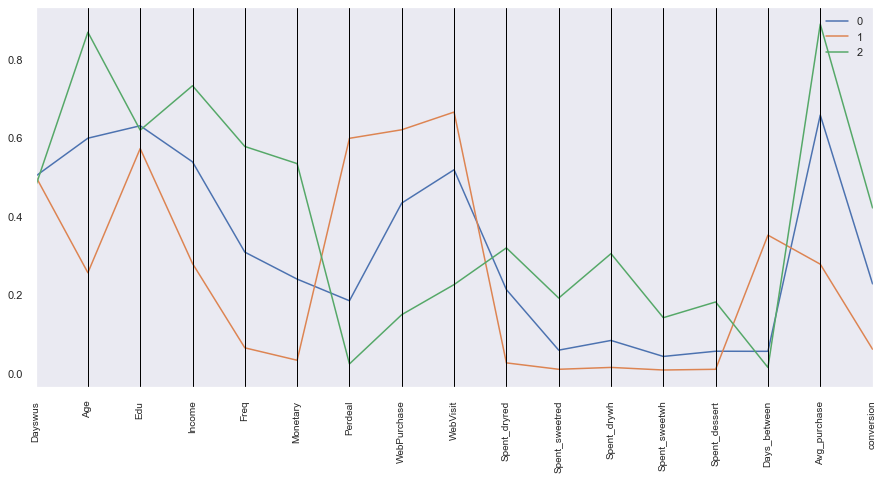

In [163]:
plt.figure(figsize=(15, 7))
pd.plotting.parallel_coordinates(kmeans_merged_scaled, class_column = "merged_labels", color=sns.color_palette())
plt.xticks(fontsize=10, rotation=90)

# Performance comparison

In [164]:
data_r2={'kmeans':[r2_kmeans,r2_kmeans_less, r2_kmeans_socio, r2_kmeans_behav, r2_kmeans_merged]}

performance_r2=pd.DataFrame(data_r2).from_dict(data_r2, orient='index', columns=['all variables',"less variables",'socio','behav','merged'])
performance_r2

,all variables,less variables,socio,behav,merged
kmeans,0.559499,0.516719,0.73377,0.669201,0.546402


In [165]:
data_davis={'kmeans':[davies_bouldin, davies_bouldin_less, davies_bouldin_socio, davies_bouldin_behav, davies_bouldin_merged]}

performance_davis=pd.DataFrame(data_davis).from_dict(data_davis, orient='index', columns=['all variables',"less_variables",'socio','behav','merged'])
performance_davis

,all variables,less_variables,socio,behav,merged
kmeans,1.339752,1.446228,0.985941,1.334567,1.360106


In [166]:
data_kalinski={'kmeans':[calinski_harabasz, calinski_harabasz_less, calinski_harabasz_socio, calinski_harabasz_behav, calinski_harabasz_merged]}

performance_calinski=pd.DataFrame(data_kalinski).from_dict(data_kalinski, orient='index', columns=['all variables', "less variables",'socio','behav','merged'])
performance_calinski

,all variables,less variables,socio,behav,merged
kmeans,6135.419876,5164.710934,8874.796905,4885.007016,5818.802922


In [167]:
#based on this we will choose the cluster with all variables

In [168]:
www_viz=www.iloc[:, :-3]

In [169]:
www_viz.drop(["analysis_labels"], axis=1, inplace=True)

In [170]:
www_viz


,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend,conversion,Avg_purchase,Days_between,Spent_dryred,Spent_sweetred,Spent_drywh,Spent_sweetwh,Spent_dessert,Spent_exotic,labels
Custid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5325,653,55,20,78473,0,0,20,18,826,445,7,36,5,0,0,0,0,0,0,0,0,0,0.08,41.30,27.00,553.42,33.04,214.76,16.52,8.26,8.26,1
3956,1041,75,18,105087,0,0,36,33,1852,539,2,20,4,0,0,0,1,0,0,0,0,0,0.10,51.44,15.00,907.48,0.00,851.92,18.52,55.56,0.00,2
3681,666,18,12,27984,1,0,4,56,39,-7,88,60,8,0,0,0,0,0,0,0,0,0,0.02,9.75,135.00,1.56,11.31,5.46,12.48,8.19,18.72,0
2829,1049,42,16,61748,1,1,2,46,37,-6,70,59,7,0,0,0,0,0,0,0,1,1,0.01,18.50,270.00,31.82,0.37,4.07,0.37,0.37,20.35,0
8788,837,47,16,65789,0,1,2,3,36,4,35,63,6,0,0,0,0,0,0,0,0,0,0.01,18.00,270.00,30.60,0.00,4.32,0.72,0.36,10.08,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1383,1132,57,20,81033,0,1,19,59,776,187,22,27,4,1,0,0,0,0,1,0,1,0,0.07,40.84,28.42,605.28,0.00,155.20,7.76,7.76,85.36,1
4070,596,66,15,84714,0,0,18,45,720,391,5,18,2,0,0,0,0,0,0,0,0,0,0.09,40.00,30.00,216.00,86.40,259.20,72.00,86.40,93.60,2
7909,619,18,12,40466,0,0,3,65,47,5,23,58,5,0,0,0,0,0,0,0,0,0,0.02,15.67,180.00,2.82,11.28,4.70,17.86,10.34,19.27,0


# Interpretation of non metric features

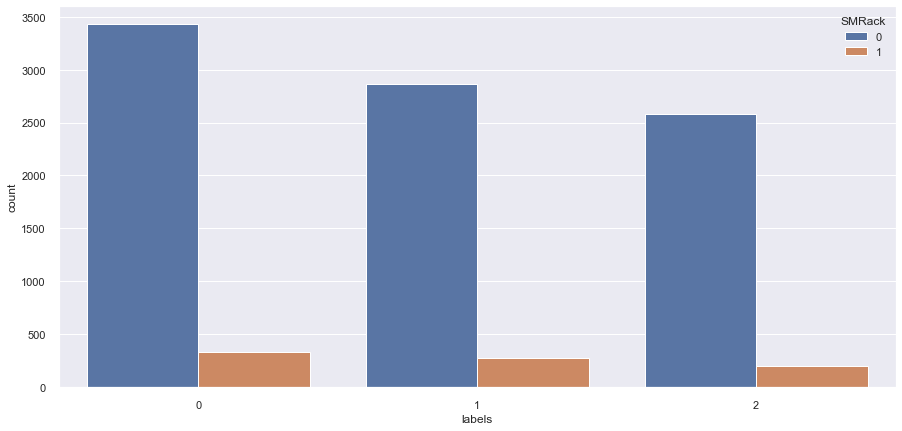

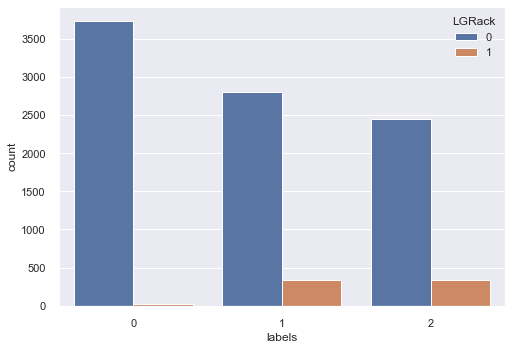

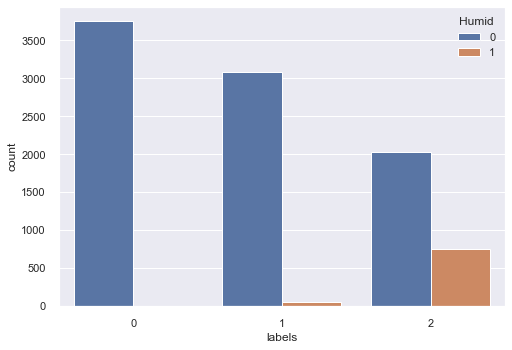

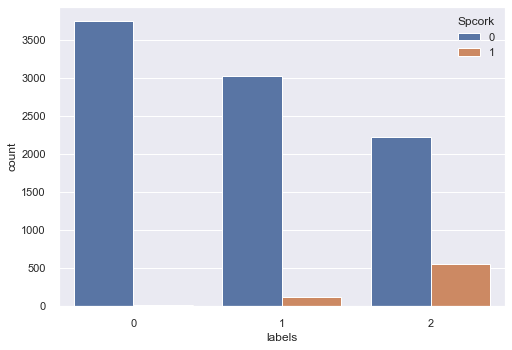

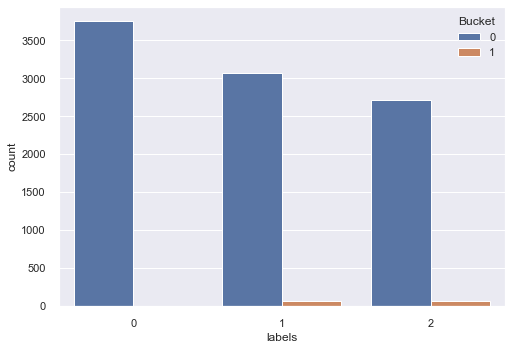

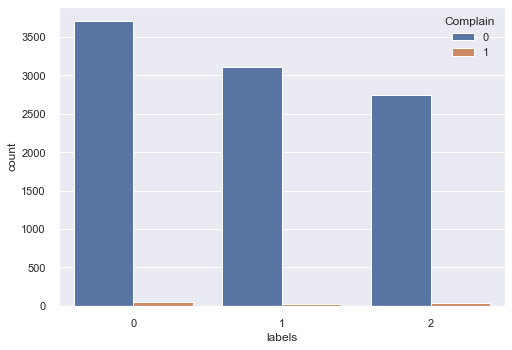

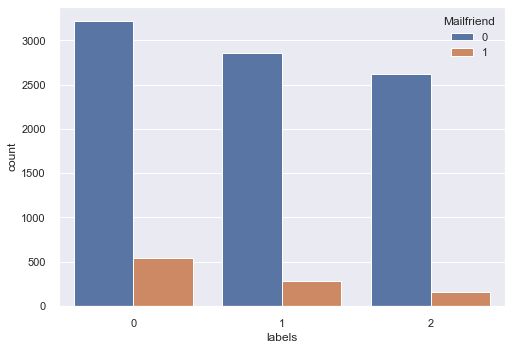

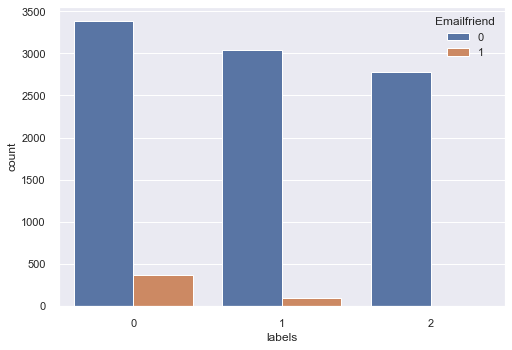

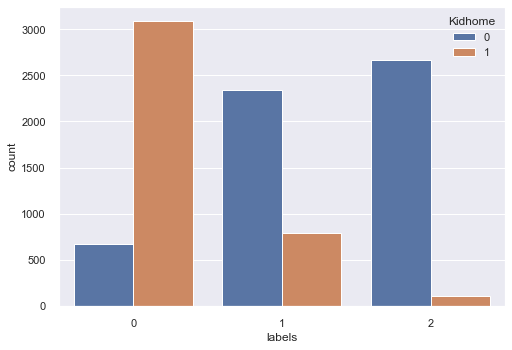

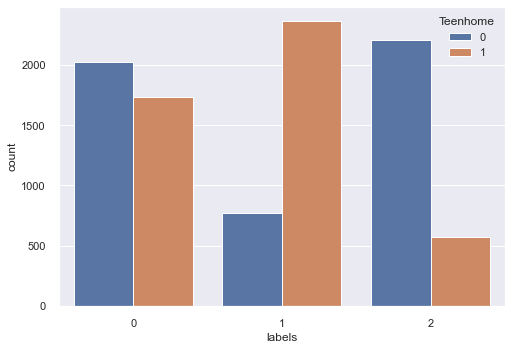

In [171]:
#graphs for the non metric features 
non_metric_features=["SMRack", "LGRack", "Humid", "Spcork", "Bucket", "Complain", "Mailfriend", "Emailfriend", "Kidhome", "Teenhome"] 
plt.figure(figsize=(15, 7))
for var in non_metric_features:
    metric_feature = sns.countplot(data=www_viz, x= 'labels', hue=var)
    plt.show()
    figure = metric_feature.get_figure()  
    name = 'barplot_'+var+'.png'
    figure.savefig(name, dpi=400)
